# Looking at the cell QC metrics, may also compare to the 500 cell library from this notebook, but not yet.
                                          

# INPUT:

    * superb_data.with-guide-imputation.h5ad

# Environment Setup

In [2]:
work_dir = './'
import os
os.chdir( work_dir )

import numpy as np
import pandas as pd

import scanpy as sc

import matplotlib.pyplot as plt

data_dir = 'superb_count_all/combined/'
out_dir = data_dir+'cell_qc_tables/'

# Loading the data

In [3]:
data = sc.read_h5ad(f'{data_dir}superb_data.with-guide-imputation.h5ad')
data

AnnData object with n_obs × n_vars = 9500 × 62754
    obs: 'bc_wells', 'sample', 'species', 'gene_count', 'tscp_count', 'mread_count', 'bc1_well', 'bc2_well', 'bc3_well', 'bc1_wind', 'bc2_wind', 'bc3_wind', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'guide_set', 'guide_set_all', 't7_umis_removed_counts', 'dosages_removed_counts', 't7_all_removed_counts', 't7_no_bc_umis_removed_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'edit_site_info', 'edit_site_info_all_guide_homology', 'edit_site_info_guide_homology', 'edit_site_info_guide_homology_and_coinc', 'edit_site_info_guide_homology_and_coinc_final', 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_u

In [55]:
data.var.keys()

Index(['n_cells_by_counts', 'mean_counts', 'log1p_mean_counts',
       'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts',
       'highly_variable', 'means', 'dispersions', 'dispersions_norm'],
      dtype='object')

In [201]:
##### Counting the mitochondrial reads per cell.
mito_genes = [gene for gene in data.var_names if gene.startswith('MT-')]
mito_counts = data[:,mito_genes].layers['gene_counts'].toarray().sum(axis=1)
mito_perc = (mito_counts.astype(float) / data.obs['total_counts'].values)*100

data.obs['mito_perc'] = mito_perc

In [202]:
sum(mito_counts)

0.0

***No mitochondrial read counts..***

***Let's count the t7 barcoded reads!***

In [203]:
data.obsm.keys()

KeysView(AxisArrays with keys: X_pca, X_umap, dosages, dosages_corrected, dosages_corrected_genes, dosages_corrected_genes_manual-edits-only, dosages_genes, dosages_genes_manual-edits-only, t7_all, t7_all_corrected, t7_no_bc_umis, t7_no_bc_umis_corrected, t7_umis, t7_umis_corrected, leiden_enrich_scores, leiden_merged_enrich_scores)

In [206]:
data.uns.keys()

dict_keys(['edit_site_info', 'edit_site_info_all_guide_homology', 'edit_site_info_guide_homology', 'edit_site_info_guide_homology_and_coinc', 'edit_site_info_guide_homology_and_coinc_final', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'sample_colors', 'phase_colors', 'leiden', 'rank_genes_groups', 'leiden_colors', 'leiden_markers', 'leiden_neighbours', 'leiden_neighdists', 'leiden_ps', 'leiden_padjs', 'leiden_mutualpairs', 'leiden_merged_markers', 'leiden_merged_colors', 'dendrogram_leiden_merged'])

In [213]:
#### Subsetting the t7 reads to just the confident edit calls!
edit_info = data.uns['edit_site_info_guide_homology_and_coinc_final']
edit_info

,name,chr,pos,start_window,end_window,intersecting_genes,copy-number,n_cells_edited,stranded_edit_dist,target_name,...,coinc_guide_seq,coinc_count,coinc_fraction,guide_score,confident_guide_call,manual_edit_call,t7_umis_removed_counts,dosages_removed_counts,t7_all_removed_counts,t7_no_bc_umis_removed_counts
hg38_1:26696719,hg38_1:26696719,1,26696719,26696579,26696859,ARID1A,4,359,0,hg38_1:26696719_2,...,AAGAACTCGAACGGGAACGCGGG,1.000000,0.754789,17.835997,True,True,89,80,8462,8373
hg38_1:26696862,hg38_1:26696862,1,26696862,26696722,26697002,ARID1A,4,102,2,hg38_1:26696862_3,...,GCTTCGGGCAACCCTACGGCCGG,1.000000,0.900261,18.043814,True,True,23,22,8605,8582
hg38_12:6602172,hg38_12:6602172,12,6602172,6602032,6602312,"ENSG00000285238,CHD4",2,2725,0,hg38_12:6602172_1,...,GCCGGCATAAGAGCATACGCTGG,1.000000,0.806920,17.910470,True,True,10,10,5391,5381
hg38_12:6606340,hg38_12:6606340,12,6606340,6606200,6606480,"ENSG00000285238,CHD4",2,179,0,hg38_12:6606340_3,...,CCTCACTGCCCGCCGAGCAGGGG,1.000000,0.919930,18.071912,True,True,33,33,4189,4156
hg38_19:10986490,hg38_19:10986490,19,10986490,10986350,10986630,SMARCA4,3,52,3,hg38_19:10986490_1,...,ACCGAGGGTGGAGGTAGCGTTGG,1.000000,0.880784,18.015990,True,True,0,0,2349,2349
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
hg38_19:3406603,hg38_19:3406603,19,3406603,3406463,3406743,NFIC,3,3,2,hg38_19:3406603_2,...,CCTCACTGCCCGCCGAGCAGGGG,0.036515,0.860227,0.234942,False,False,3,3,813,810
hg38_10:73387744,hg38_10:73387744,10,73387744,73387604,73387884,ANXA7,4,3,9,hg38_10:73387744_1,...,GCCGGCATAAGAGCATACGCTGG,0.005002,0.744555,0.171024,False,False,0,0,838,838
hg38_7:155680729,hg38_7:155680729,7,155680729,155680589,155680869,RBM33,5,9,1,hg38_7:155680729_3,...,AAGAACTCGAACGGGAACGCGGG,0.047298,0.312443,-0.536312,False,False,7,7,8270,8263
hg38_17:64502467,hg38_17:64502467,17,64502467,64502327,64502607,DDX5,3,5,9,hg38_17:64502467_1,...,GCTTCGGGCAACCCTACGGCCGG,0.033520,0.395990,-0.434283,False,False,5,5,22686,22681


In [214]:
conf_bool = edit_info[ 'manual_edit_call' ].values

conf_edits = edit_info.index.values[ conf_bool ]
len( conf_edits )

43

In [215]:
data.obsm['t7_umis'].iloc[0:3,0:3]

,hg38_1:26696719,hg38_1:224544957,hg38_1:26696862
03_01_02,0,0,0
03_01_06,0,0,0
03_01_30,0,0,0


In [216]:
t7_umis = data.obsm['t7_umis'].loc[:,conf_edits].sum(axis=1).values

In [217]:
t7_umis

array([ 0, 16, 35, ...,  4,  2,  1])

In [218]:
data.obs['t7_umis'] = t7_umis

In [219]:
data.obs['t7_all'] = data.obsm['t7_all'].loc[:,conf_edits].sum(axis=1).values

In [220]:
data.obs['t7_no_bc_umis'] = data.obsm['t7_no_bc_umis'].loc[:,conf_edits].sum(axis=1).values

# Per cell metrics

In [ ]:
def pie(labels: np.array, label_set: np.array=None,
        colors: dict=None, min_perc: float=3, autopct: str='',
        labeldistance=1.05, explode_f=0.8,
        filter_perc=0, show_perc=False, show_size=False, print_filt=False, figsize=(5,5),
        show=True):
    """Piechart, but formatted nicely, e.g. will order pies & explode out
        low frequency labels.

    Args:

        min_perc (float): Percentage below which labels will 'explode'.
        filter_perc (float): Percentage below which labels will not be shown.

    """
    if type(label_set)==type(None):
        label_set = np.unique(labels)

    sizes = np.array([len(np.where(labels == dataset)[0])
                      for dataset in label_set])
    percs = np.array([(size / sum(sizes)) * 100 for size in sizes])

    if filter_perc > 0:
        perc_filt = percs > filter_perc
        if print_filt:
            print( label_set[perc_filt==False] )

        remain_size = sum(sizes[perc_filt == False])
        sizes = np.array(list(sizes[perc_filt]) + [remain_size])
        remain_perc = sum(percs[perc_filt == False])
        percs = np.array(list(percs[perc_filt]) + [remain_perc])

        label_set = np.array(list(label_set[perc_filt]) + [f'other'])

    if show_perc:
        label_set = np.array([f'{label} ({round(perc, 2)}%)'
                              for label, perc in zip(label_set, percs)])
    elif show_size:
        label_set = np.array([f'{label} (n={round(size_, 2)})'
                              for label, size_ in zip(label_set, sizes)])

    order = np.argsort(-sizes)
    sizes = sizes[order]
    label_set = label_set[order]
    percs = percs[order]

    ### Getting the colors, will add this to scripts.helpers so consistent ###
    if type(colors)==type(None):
        colors = vhs.getColors(label_set)

    colors_ = [colors[dataset] for dataset in label_set]
    end = sum(percs<min_perc)
    explode = [0] * (len(label_set) - end) + [explode_f * (i + 1) for i in list(
        range(end))]  # Expand out less numerous data...

    fig1, ax1 = plt.subplots(figsize=figsize)
    ax1.pie(sizes, labels=label_set, autopct=autopct,  # '%0.1f%%',
            shadow=False, startangle=90, colors=colors_, explode=explode,
            labeldistance=labeldistance)
    ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

    if show:
        plt.show()
    else:
        return fig1, ax1

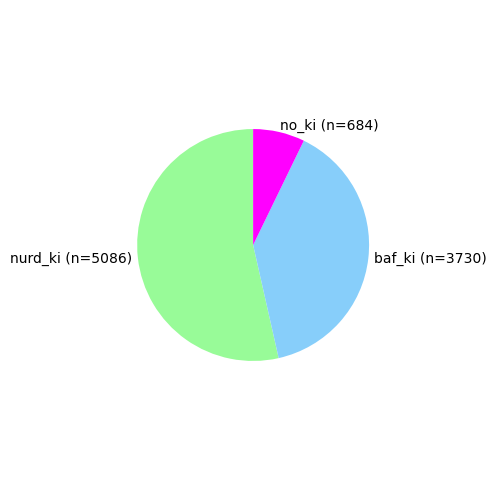

In [255]:
#### Pie chart of the cells captured in the different samples
sample_colors = {'nurd_ki': 'palegreen', 'baf_ki': 'lightskyblue', 'no_ki': 'magenta'}
sample_colors_wSizes = {'nurd_ki (n=5086)': sample_colors['nurd_ki'], 
                        'baf_ki (n=3730)': sample_colors['baf_ki'], 
                        'no_ki (n=684)': sample_colors['no_ki']}

pie(data.obs['sample'].values, colors=sample_colors_wSizes, show_size=True, show=False)
plt.show()

# Let's also get the proportion of these that have the on-target edit in each cell, and evidence of off-target in different combinations..

In [298]:
sample_labels = data.obs['sample'].values

dosages_genes = data.obsm['dosages_corrected_genes_manual-edits-only']
arid1a_edited = dosages_genes['ARID1A'].values > 0
smarca4_edited = dosages_genes['SMARCA4'].values > 0
chd3_edited = dosages_genes['CHD3'].values > 0
chd4_edited = dosages_genes['CHD4'].values > 0

any_edited = dosages_genes.sum(axis=1) > 0

In [299]:
np.unique( sample_labels )

array(['baf_ki', 'no_ki', 'nurd_ki'], dtype=object)

In [297]:
len(any_edited)

9500

In [502]:
def double_label(edit_bool_1, edit_bool_2, gene_1, gene_2, any_edited_bool):
    
    cell_label = 'no-edit'
    if edit_bool_1 and not edit_bool_2:
        cell_label = f'{gene_1}-edit'
    elif not edit_bool_1 and edit_bool_2:
        cell_label = f'{gene_2}-edit'
    elif edit_bool_1 and edit_bool_2:
        cell_label = f'double-edit'

    if any_edited_bool and cell_label!='no-edit':
        cell_label = cell_label + ', off-target/s'
    elif any_edited_bool:
        cell_label = 'off-target/s'
        
    return cell_label

In [503]:
cell_labels = []
for i in range(len(sample_labels)):

    if sample_labels[i] == 'no_ki' and any_edited[i]:
        cell_labels.append( 'false-edit-call' )

    elif sample_labels[i] == 'no_ki':
        cell_labels.append( 'no-edit' )

    elif sample_labels[i] == 'baf_ki':
        cell_labels.append( double_label(arid1a_edited[i], smarca4_edited[i], 'ARID1A', 'SMARCA4', any_edited[i]) )

    elif sample_labels[i] == 'nurd_ki':
        cell_labels.append( double_label(chd3_edited[i], chd4_edited[i], 'CHD3', 'CHD4', any_edited[i]) )

In [504]:
np.unique(cell_labels)

array(['ARID1A-edit, off-target/s', 'CHD3-edit, off-target/s',
       'CHD4-edit, off-target/s', 'SMARCA4-edit, off-target/s',
       'double-edit, off-target/s', 'false-edit-call', 'no-edit',
       'off-target/s'], dtype='<U26')

In [505]:
data.obs['edit_cell_labels'] = cell_labels
data.obs['edit_cell_labels'] = data.obs['edit_cell_labels'].astype('category')

In [ ]:
def get_overlap_counts(data, groupby1: str, groupby2: str,
                       uns_key: str = 'annot_overlaps',
                       verbose: bool = True):
    """ Calculates no. of cells belonging to the different categories of groupby1 and groupby2.
    """

    labels = data.obs[groupby1].values.astype(str)
    label_set = np.array(list(data.obs[groupby1].cat.categories))

    labels2 = data.obs[groupby2].values.astype(str)
    label_set2 = np.array(list(data.obs[groupby2].cat.categories))

    overlap_counts = np.zeros((len(label_set), len(label_set2)))
    for i, label in enumerate(label_set):
        label_bool = labels == label
        for j, label2 in enumerate(label_set2):
            label_bool2 = labels2 == label2

            overlap_counts[i, j] = len(
                np.where(np.logical_and(label_bool, label_bool2))[0])

    overlap_counts_df = pd.DataFrame(overlap_counts, index=label_set,
                                     columns=label_set2)
    data.uns[uns_key] = overlap_counts_df
    if verbose:
        print(f"Added data.uns['{uns_key}']")

In [537]:
get_overlap_counts(data, 'sample', 'edit_cell_labels')

Added data.uns['annot_overlaps']


In [538]:
data.uns['annot_overlaps']

,"ARID1A-edit, off-target/s","CHD3-edit, off-target/s","CHD4-edit, off-target/s","SMARCA4-edit, off-target/s","double-edit, off-target/s",false-edit-call,no-edit,off-target/s
baf_ki,234.0,0.0,0.0,640.0,119.0,0.0,1131.0,1606.0
no_ki,0.0,0.0,0.0,0.0,0.0,32.0,652.0,0.0
nurd_ki,0.0,668.0,1635.0,0.0,1081.0,0.0,1487.0,215.0


In [508]:
#### Want to see the actual proportions:
totals = data.uns['annot_overlaps'].values.sum(axis=1)
proportions = np.apply_along_axis(np.divide, 0, data.uns['annot_overlaps'].values, totals)

pd.DataFrame(proportions, index=data.uns['annot_overlaps'].index, columns=data.uns['annot_overlaps'].columns)

,"ARID1A-edit, off-target/s","CHD3-edit, off-target/s","CHD4-edit, off-target/s","SMARCA4-edit, off-target/s","double-edit, off-target/s",false-edit-call,no-edit,off-target/s
baf_ki,0.062735,0.000000,0.000000,0.171582,0.031903,0.000000,0.303217,0.430563
no_ki,0.000000,0.000000,0.000000,0.000000,0.000000,0.046784,0.953216,0.000000
nurd_ki,0.000000,0.131341,0.321471,0.000000,0.212544,0.000000,0.292371,0.042273


In [509]:
proportions.sum(axis=1)

array([1., 1., 1.])

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


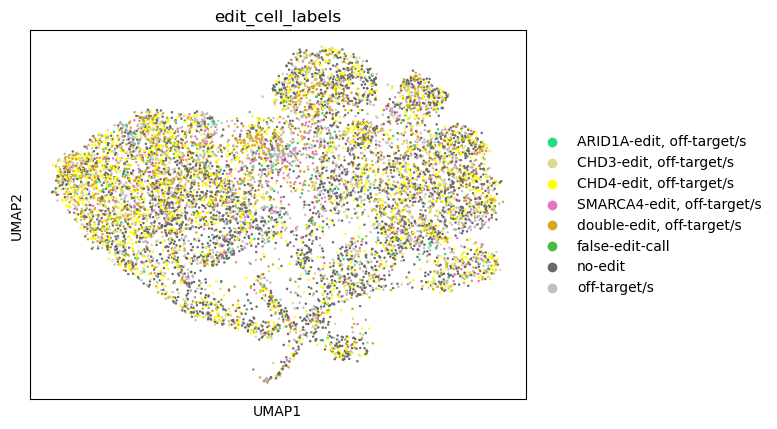

In [510]:
sc.pl.umap(data, color='edit_cell_labels')

In [ ]:
import numpy
import matplotlib

def getOrderedLabelSet(labels):
	""" Gets the set of labels associated with labels ordered from most to \
		least frequent.
	"""
	labelSet = list(set(labels))
	freqs = numpy.array([len(numpy.where(labels == label)[0])
						 for label in labelSet])
	order = numpy.array(list((-freqs).argsort()))
	labelSetOrdered = list(numpy.array(labelSet)[order])

	return labelSetOrdered

def getColors(labels, labelSet=None, colorMap='tab20', rgb=False):
	""" Gets an OrderedDict of colors; the order indicates the frequency of \
	labels from largest to smallest.

	Args:
		labels (numpy.array<str>): Indicates a set of labels for observations.

		labelSet (list-like<str>): Indicates the set of labels in labels. \
									If None, calculated based on labels.

		colorMap (str): A matplotlib colormap.

		rgb (bool): If True, colors indicated by rgb value, if false hexcode.

	Returns:
		dict<str, tuple or str>: An ordered dict indicating the labels which \
					occur most to least frequently and the associated colors.
	"""
	# Determining the set of labels #
	labelSet = input.returnDefaultIfNone(labelSet,
										 getOrderedLabelSet(labels))

	# Initialising the ordered dict #
	cellTypeColors = {}

	# Ordering the cells according to their frequency and obtaining colors #
	nLabels = len(labelSet)
	cmap = plt.cm.get_cmap(colorMap, nLabels)
	rgbs = [cmap(i)[:3] for i in range(nLabels)]
	#rgbs = list(numpy.array(rgbs)[order]) # Make sure color order is the same.

	# Populating the color dictionary with rgb values or hexcodes #
	for i in range(len(labelSet)):
		cellType = labelSet[i]
		rgbi = rgbs[i]
		if not rgb:
			cellTypeColors[cellType] = matplotlib.colors.rgb2hex(rgbi)
		else:
			cellTypeColors[cellType] = rgbi

	return cellTypeColors

In [511]:
color_dict = getColors(cell_labels)
data.uns['edit_cell_labels_colors'] = [color_dict[label_] for label_ in data.obs['edit_cell_labels'].cat.categories]

In [512]:
data.obs['edit_cell_labels'].cat.categories

Index(['ARID1A-edit, off-target/s', 'CHD3-edit, off-target/s',
       'CHD4-edit, off-target/s', 'SMARCA4-edit, off-target/s',
       'double-edit, off-target/s', 'false-edit-call', 'no-edit',
       'off-target/s'],
      dtype='object')

In [533]:
color_dict = getColors(cell_labels)

color_dict['no-edit'] = 'silver'
color_dict['false-edit-call'] = 'dimgrey'
color_dict['off-target/s'] = 'sienna'#'crimson'
color_dict['CHD3-edit, off-target/s'] = 'yellow'
color_dict['CHD4-edit, off-target/s'] = 'goldenrod'
color_dict['ARID1A-edit, off-target/s'] = 'lime' #'#20DF7F'
color_dict['SMARCA4-edit, off-target/s'] = 'green' #'#45BA45'
color_dict['double-edit, off-target/s'] = 'palegoldenrod'
data.uns['edit_cell_labels_colors'] = [color_dict[label_] for label_ in data.obs['edit_cell_labels'].cat.categories]

In [534]:
color_dict

{'ARID1A-edit, off-target/s': 'lime',
 'no-edit': 'silver',
 'off-target/s': 'sienna',
 'CHD4-edit, off-target/s': 'goldenrod',
 'false-edit-call': 'dimgrey',
 'double-edit, off-target/s': 'palegoldenrod',
 'SMARCA4-edit, off-target/s': 'green',
 'CHD3-edit, off-target/s': 'yellow'}

In [ ]:
def dataframe_annot_overlap_barplot(overlap_counts_df, groupby1, groupby2, colors=None,
                          bar_width: float = .85,
                          labelset1 = None, labelset2 = None,
                          figsize=(10, 5), scale: bool = True,
                          transpose: bool = False, edge_color=None,
                          remove_labelling: bool = False):
    """Plots relationship between annotations by showing proportions of each type found within
        each of the other categories.
    """
    if transpose:  ##### Looking at relationship in opposite direction.
        overlap_counts_df = overlap_counts_df.transpose()
        tmp = groupby1
        groupby1 = groupby2
        groupby2 = tmp

    if type(labelset1)==type(None):
        labelset1 = overlap_counts_df.index.values
    else:
        overlap_counts_df = overlap_counts_df.loc[labelset1, :]

    if type(labelset2) == type(None):
        labelset2 = overlap_counts_df.columns.values
    else:
        overlap_counts_df = overlap_counts_df.loc[:, labelset2]

    ##### Getting colors
    if type(colors)==type(None):
        colors = {val: 'grey' for i, val in enumerate(labelset2)}

    ##### Scaling the data to proportions.
    if scale:
        total_counts = overlap_counts_df.sum(axis=1)
        overlap_counts = np.apply_along_axis(np.divide, 0,
                                             overlap_counts_df.values,
                                             total_counts)
    else:
        overlap_counts = overlap_counts_df.values

    ##### Creating the barplots...
    fig, axs = plt.subplots(figsize=figsize)
    col_locs = list(range(len(labelset1)))
    for labeli, label in enumerate(labelset2):
        props = overlap_counts[:, labeli]

        if labeli == 0:
            bottom = [0] * len(props)

        axs.bar(col_locs, props, bottom=bottom,
                color=colors[label], edgecolor=edge_color,
                width=bar_width, )
        bottom = list(np.array(bottom) + props)

        # Custom x axis
        axs.set_xticks(list(range(len(labelset1))), list(labelset1),
                       rotation=90)
        axs.spines['right'].set_visible(False)
        axs.spines['top'].set_visible(False)
        if remove_labelling:
            axs.set_xticks([])
            axs.set_yticks([])
            axs.spines['left'].set_visible(False)
            axs.spines['bottom'].set_visible(False)
        else:
            axs.set_xlabel(f"{groupby1} Clusters")

def annot_overlap_barplot(data, groupby1: str, groupby2: str,
                          uns_key: str = 'annot_overlaps',
                          labelset1 = None, labelset2 = None,
                          bar_width: float = .85,
                          figsize=(10, 5), scale: bool = True,
                          transpose: bool = False, edge_color=None,
                          remove_labelling: bool = False):
    """Plots relationship between annotations by showing proportions of each type found within
        each of the other categories. Written to work with AnnData input.
    """
    if uns_key not in data.uns:
        print("Need to run get_overlap_counts() first.")

    overlap_counts_df = data.uns[uns_key].copy()

    # ##### Getting colors
    if f'{groupby2}_colors' in data.uns:
        colors = {val: data.uns[f'{groupby2}_colors'][i]
                  for i, val in enumerate(data.obs[groupby2].cat.categories)}
    else:
        colors = {val: 'grey' for
                  i, val in enumerate(data.obs[groupby2].cat.categories)}


    dataframe_annot_overlap_barplot(overlap_counts_df, groupby1, groupby2, colors=colors,
                          bar_width = bar_width,
                          labelset1 = labelset1, labelset2 = labelset2,
                          figsize=figsize, scale=scale,
                          transpose=transpose, edge_color=edge_color,
                          remove_labelling=remove_labelling)

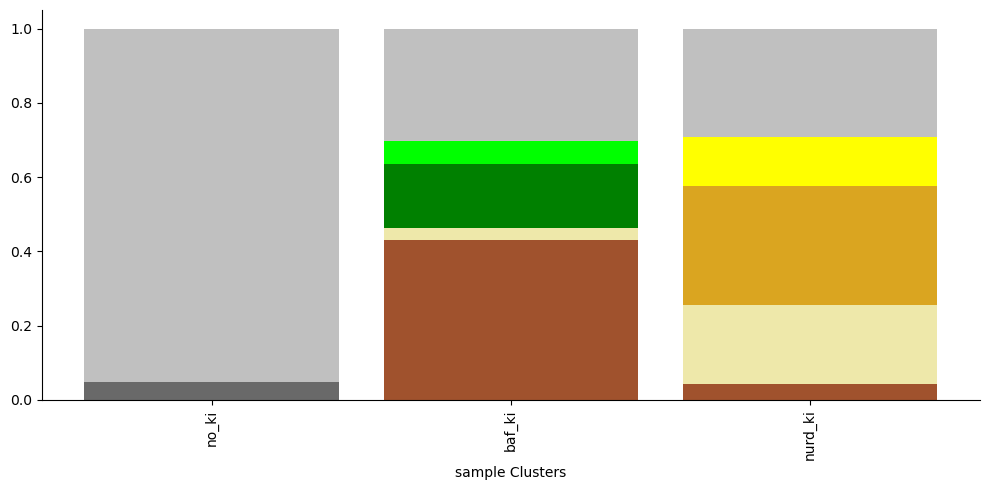

In [539]:
annot_overlap_barplot(data, 'sample', 'edit_cell_labels',
                         labelset1=np.array(['no_ki', 'baf_ki', 'nurd_ki']),
                         labelset2=np.array(['no-edit', 'false-edit-call',
                                            'ARID1A-edit, off-target/s', 'SMARCA4-edit, off-target/s',
                                            'CHD3-edit, off-target/s', 'CHD4-edit, off-target/s',
                                             'double-edit, off-target/s',
                                             'off-target/s'
                                            ][::-1])
                         )
plt.show()

# Now for the proportion of allele calls of each on-target, to understand allelic dosages.

Added data.uns['annot_overlaps']


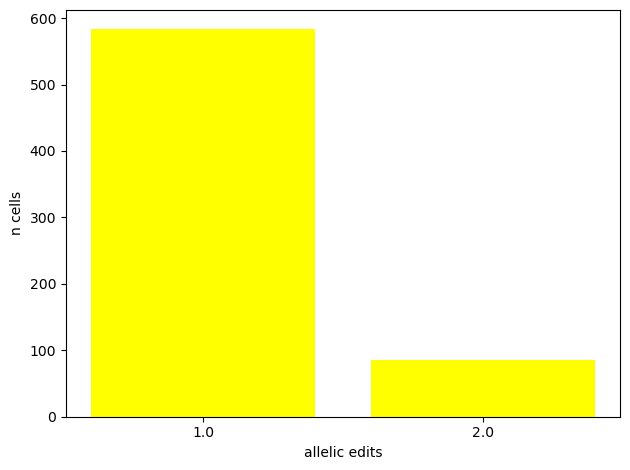

Added data.uns['annot_overlaps']


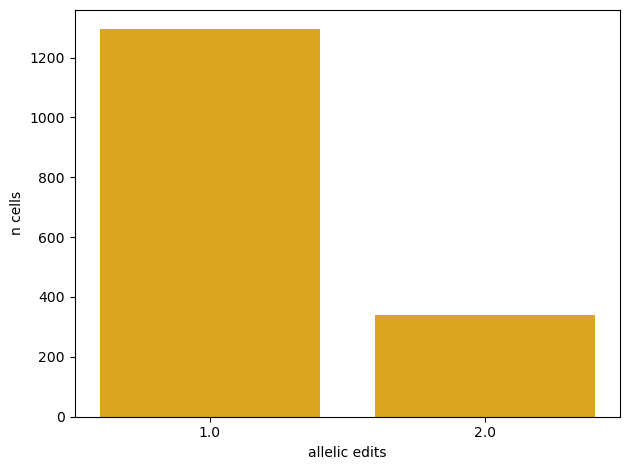

Added data.uns['annot_overlaps']


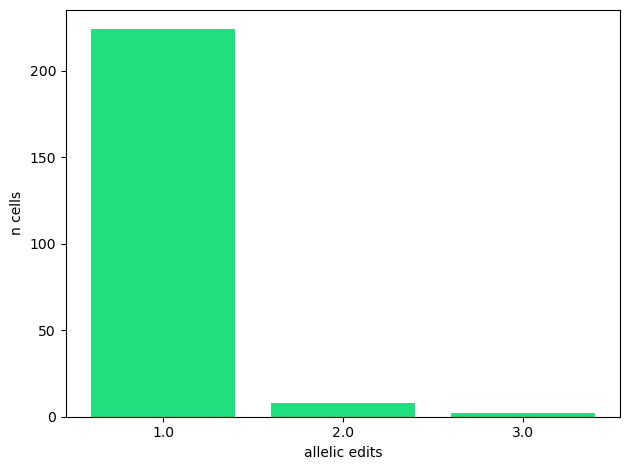

Added data.uns['annot_overlaps']


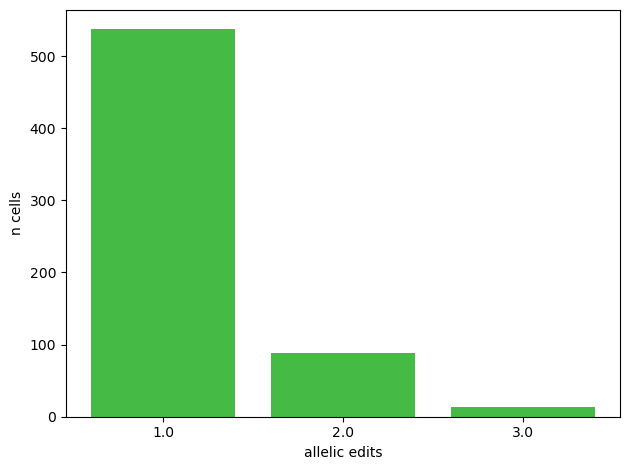

In [527]:
on_targets = ['CHD3', 'CHD4', 'ARID1A', 'SMARCA4']
samples_ = ['nurd_ki', 'nurd_ki', 'baf_ki', 'baf_ki']
colors_  = ['yellow', 'goldenrod', '#20DF7F', '#45BA45']

# Constructing own overlaps...
allelic_counts = np.zeros((len(on_targets), 3))

for i, (sample_, gene_) in enumerate( zip(samples_, on_targets) ):

    color_ = colors_[i]
    data.obs[f"{gene_}_edit_dosages"] = dosages_genes[gene_].values.astype(str)
    data.obs[f"{gene_}_edit_dosages"] = data.obs[f"{gene_}_edit_dosages"].astype('category')

    get_overlap_counts(data, 'edit_cell_labels', f"{gene_}_edit_dosages")

    # This part only works cause no-cases where have a pure edit with no-off-targets detected.
    allele_counts = data.uns['annot_overlaps'].loc[f'{gene_}-edit, off-target/s'].values[1:]
    alleles = data.uns['annot_overlaps'].columns.values[1:]

    allelic_counts[i,0:len(alleles)] = allele_counts
    
    plt.bar(alleles, allele_counts,
       color=color_)
    plt.xlabel('allelic edits')
    plt.ylabel('n cells')

    plt.show()

In [518]:
allelic_counts = pd.DataFrame(allelic_counts, index=on_targets, columns=list(range(1,allelic_counts.shape[1]+1)))
allelic_counts

,1,2,3
CHD3,583.0,85.0,0.0
CHD4,1294.0,341.0,0.0
ARID1A,224.0,8.0,2.0
SMARCA4,537.0,89.0,14.0


In [520]:
data.uns['annot_overlaps'] = allelic_counts

In [521]:
totals = data.uns['annot_overlaps'].values.sum(axis=1)
proportions = np.apply_along_axis(np.divide, 0, data.uns['annot_overlaps'].values, totals)

pd.DataFrame(proportions, index=data.uns['annot_overlaps'].index, columns=data.uns['annot_overlaps'].columns)

,1,2,3
CHD3,0.872754,0.127246,0.000000
CHD4,0.791437,0.208563,0.000000
ARID1A,0.957265,0.034188,0.008547
SMARCA4,0.839063,0.139063,0.021875


In [522]:
data.uns.keys()

dict_keys(['edit_site_info', 'edit_site_info_all_guide_homology', 'edit_site_info_guide_homology', 'edit_site_info_guide_homology_and_coinc', 'edit_site_info_guide_homology_and_coinc_final', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'sample_colors', 'phase_colors', 'leiden', 'rank_genes_groups', 'leiden_colors', 'leiden_markers', 'leiden_neighbours', 'leiden_neighdists', 'leiden_ps', 'leiden_padjs', 'leiden_mutualpairs', 'leiden_merged_markers', 'leiden_merged_colors', 'dendrogram_leiden_merged', 'annot_overlaps', 'edit_cell_labels_colors', 'USP9X_edit_dosages_colors', 'annot_overlap'])

In [524]:
np.unique([-1]+list(allelic_counts.columns.values.astype(int)))

array([-1,  1,  2,  3])

In [525]:
allele_colors = getColors(np.unique([0]+list(allelic_counts.columns.values.astype(int))), colorMap='Blues')
allele_colors

{0: '#f7fbff', 1: '#abd0e6', 2: '#3787c0', 3: '#08306b'}

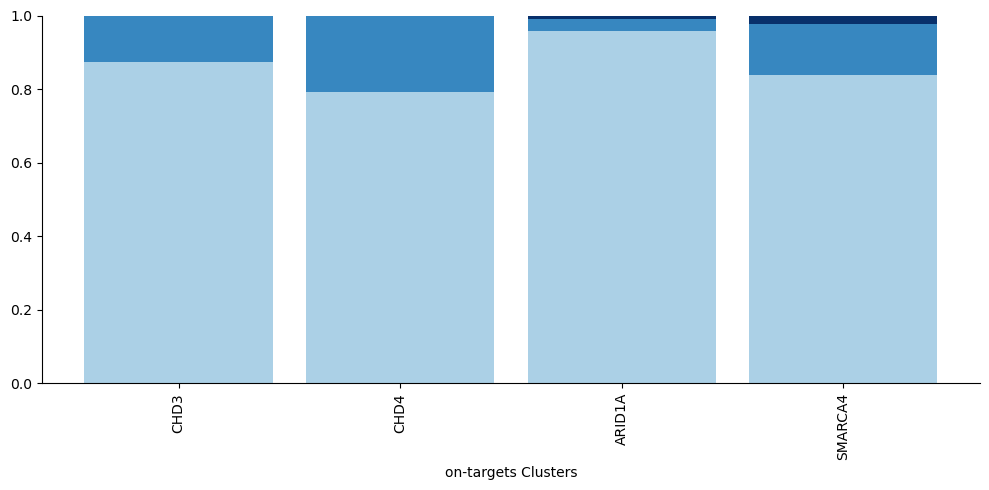

In [526]:
dataframe_annot_overlap_barplot(allelic_counts, 'on-targets', 'alleles-edited', colors=allele_colors)
plt.show()

In [222]:
#### Some stats on the total counts per cell!
total_counts = data.obs['total_counts'].values

min_, median, max_ = np.quantile(total_counts, [0, 0.5, 1])

print("Min, median, max:", min_, median, max_)

Min, median, max: 1137.0 24094.0 409262.0


In [223]:
sample_labels = data.obs['sample'].values
sample_set = np.unique(sample_labels)

In [ ]:
def distrib(x, bins=100, x_label='', fig_title='', log=False, density=False,
            figsize=(6.4,4.8), file_name=None, add_mean=False, logbase=np.e,
            color='blue', alpha=1, ax=None, fig=None, show=True, cutoff=None,
            cutoff_color='r',
            label='', total=None, return_total=False, ylims=None, xlims=None,
            mean_fontsize='small', mean_fontweight='bold'):
    """Plots a histogram of values."""
    if type(ax)==type(None) or type(fig)==type(None):
        fig, ax = plt.subplots(figsize=figsize)

    # Getting the counts in desired format #
    counts, bins = np.histogram(x, bins=bins)
    logcounts = np.log(counts+1)/np.log(logbase) if log else counts
    if density and type(total)==type(None):
        total = sum(logcounts)
        logcounts = logcounts/total
    elif density:
        logcounts = logcounts/total

    ax.hist(bins[:-1], bins, weights=logcounts, color=color, alpha=alpha,
            label=label)
    ax.set_xlabel(x_label, fp)
    if not density:
        ax.set_ylabel(f'log{round(logbase, 2)}-counts' if log else 'counts', fp)
    else:
        ax.set_ylabel('density-'+f'log{round(logbase, 2)}-counts'
                                                      if log else 'density', fp)
    fig.suptitle(fig_title)

    if add_mean:
        mean = np.mean(x)
        y = ax.get_ylim()[1]*.5
        ax.vlines(mean, 0, y, colors=cutoff_color)
        ax.text(mean, y, f'mean:{round(mean, 4)}', c=cutoff_color,
                fontsize=mean_fontsize, fontweight=mean_fontweight)
    if cutoff:
        y = ax.get_ylim()[1] * .5
        ax.vlines(cutoff, 0, y, colors=cutoff_color)
        ax.text(cutoff, y, f'cutoff: {round(cutoff, 4)}', c=cutoff_color,
                fontsize=mean_fontsize, fontweight=mean_fontweight)

    # Add axes these limits #
    if type(xlims)!=type(None):
        ax.set_xlim(*xlims)
    if type(ylims)!=type(None):
        ax.set_ylim(*ylims)

    # Removing boxes outside #
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    if show:
        #vhs.dealWithPlot(type(file_name)!=type(None), True, True, '',
        #                                                        file_name, 300)
        plt.show()
    elif not return_total:
        return fig, ax
    else:
        return fig, ax, total

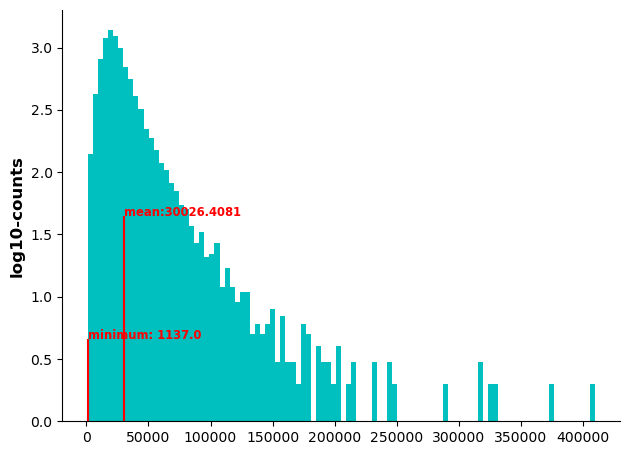

In [225]:
fig, ax = distrib(total_counts, color='c', log=True, logbase=10, add_mean=True, show=False)

cutoff = min_
cutoff_color = 'red'
y = ax.get_ylim()[1] * .2
mean_fontsize='large'
mean_fontweight='bold'
ax.vlines(cutoff, 0, y, colors=cutoff_color)
ax.text(cutoff, y, f'minimum: {round(cutoff, 4)}', c=cutoff_color,
        fontsize=mean_fontsize, fontweight=mean_fontweight)

plt.show()

In [563]:
edit_info = data.uns['edit_site_info_guide_homology_and_coinc_final']
edit_info.columns

Index(['name', 'chr', 'pos', 'start_window', 'end_window',
       'intersecting_genes', 'copy-number', 'n_cells_edited',
       'stranded_edit_dist', 'target_name', 'target_start', 'target_end',
       'target_seq', 'target_pam', 'strand', 'offset', 'abs_offset',
       'homol_guide_name', 'homol_guide_seq', 'homol_guide_pam', 'target_aln',
       'guide_aln', 'hamming_aln_distance', 'hamming_aln_indel_corrected',
       'match_aln_count', 'coinc_guide_name', 'coinc_guide_seq', 'coinc_count',
       'coinc_fraction', 'guide_score', 'confident_guide_call',
       'manual_edit_call', 't7_umis_removed_counts', 'dosages_removed_counts',
       't7_all_removed_counts', 't7_no_bc_umis_removed_counts'],
      dtype='object')

In [566]:
on_targets = ['CHD3', 'CHD4', 'ARID1A', 'SMARCA4']

on_target_edits = [edit_row['name'] for i, edit_row in edit_info.iterrows() if np.any([on_target in edit_row['intersecting_genes'] for on_target in on_targets])]
on_target_edits

['hg38_1:26696719',
 'hg38_1:26696862',
 'hg38_12:6602172',
 'hg38_12:6606340',
 'hg38_19:10986490',
 'hg38_19:10984175',
 'hg38_17:7890653']

In [568]:
edit_info.loc[on_target_edits,['intersecting_genes', 'offset', 'abs_offset', 'homol_guide_name']]

,intersecting_genes,offset,abs_offset,homol_guide_name
hg38_1:26696719,ARID1A,1,1,ARID1A g05
hg38_1:26696862,ARID1A,3,3,ARID1A g06
hg38_12:6602172,"ENSG00000285238,CHD4",1,1,CHD4 g14
hg38_12:6606340,"ENSG00000285238,CHD4",1,1,CHD4 g12
hg38_19:10986490,SMARCA4,-1,1,SMARCA4 g22
hg38_19:10984175,SMARCA4,0,0,SMARCA4 g19
hg38_17:7890653,CHD3,1,1,CHD3 g10


In [554]:
tenk_ranges = {'t7_umis': [0, 160],
 't7_no_bc_umis': [0, 477],
 't7_all': [0, 494],
 'total_counts': [1137.0, 409262.0],
 'pct_counts_in_top_100_genes': [8.095781071835804, 33.15808340303501],
 'n_genes_by_counts': [890, 15605]}

fiveh_ranges = {'t7_umis': [0, 107],
 't7_no_bc_umis': [0, 157],
 't7_all': [0, 215],
 'total_counts': [6906.0, 241211.0],
 'pct_counts_in_top_100_genes': [11.711418938132185, 45.63162184189079],
 'n_genes_by_counts': [3151, 13221]}

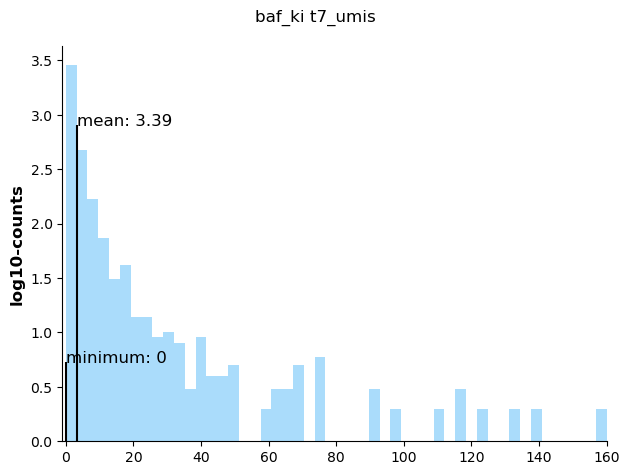

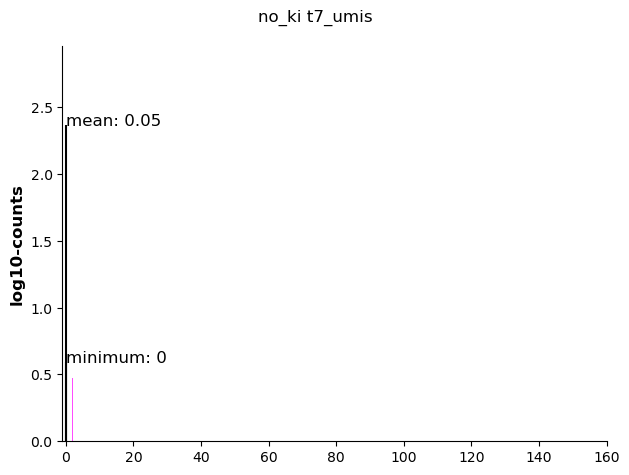

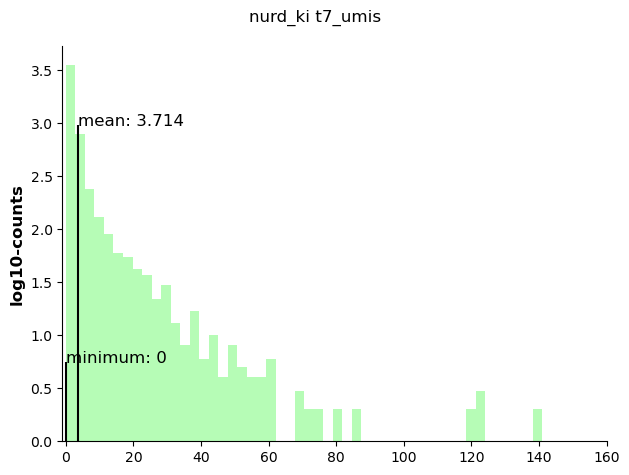

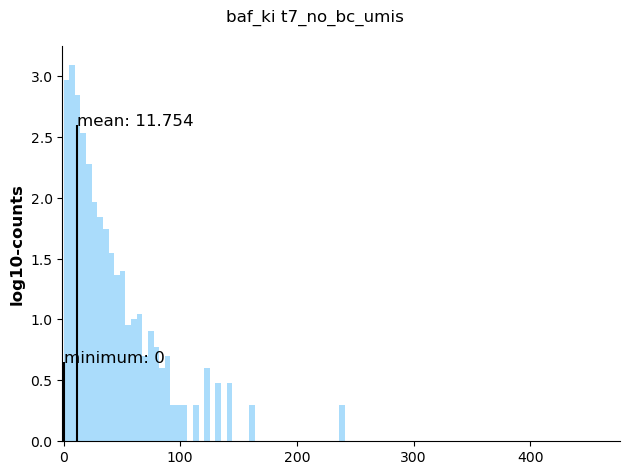

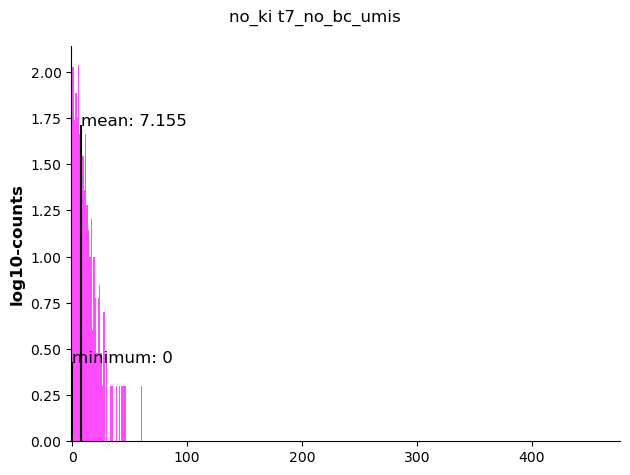

...

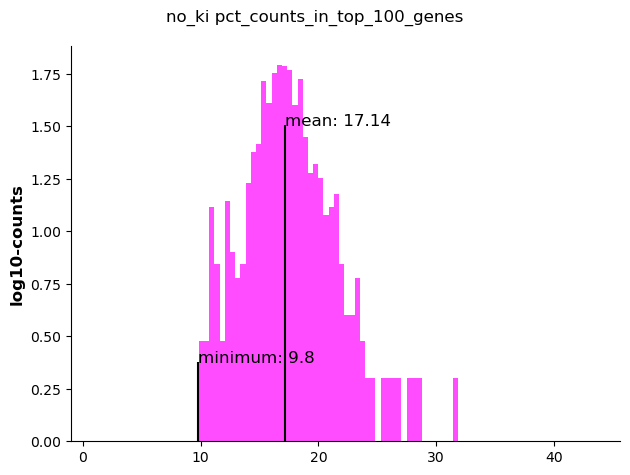

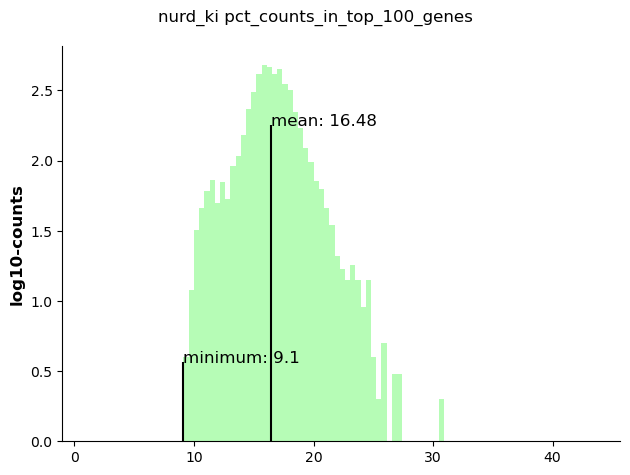

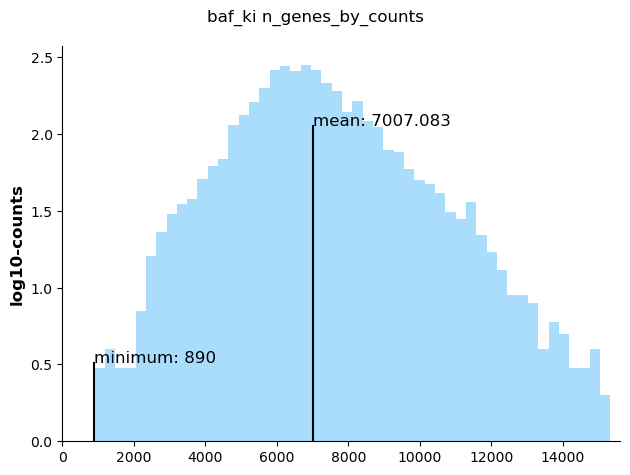

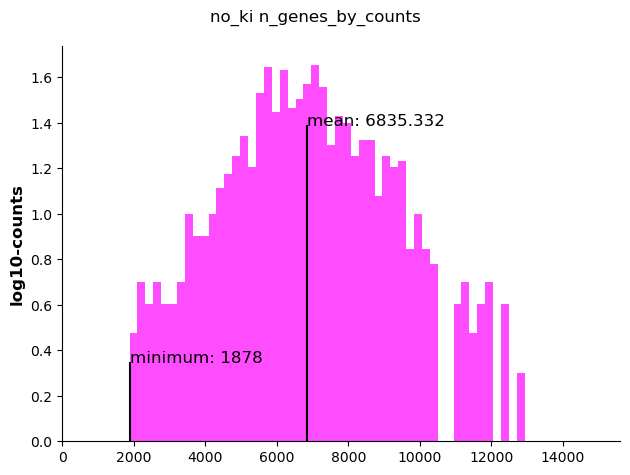

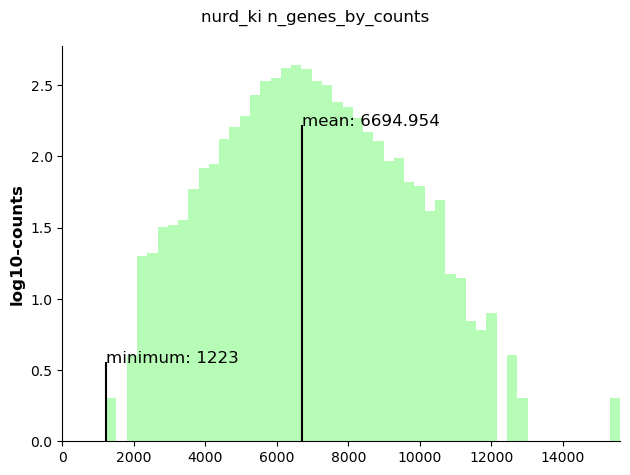

In [558]:
### Collecting the min and maxes so can set the ranges.
stratified_ranges = {}

for metric in ['t7_umis', 't7_no_bc_umis', 't7_all', 'total_counts', 'pct_counts_in_top_100_genes', 'n_genes_by_counts']:

    measures = data.obs[metric].values

    stratified_ranges[metric] = [999999999, 0]

    tenk_xlims = tenk_ranges[metric]
    fiveh_xlims = fiveh_ranges[metric]
    xlims = (np.min([tenk_xlims[0], fiveh_xlims[0], -1]),
             np.max([tenk_xlims[1], fiveh_xlims[1]]))
    
    for sample in sample_set:
        sample_meaures = measures[sample_labels==sample]

        stratified_ranges[metric] = [np.min([np.min(sample_meaures), stratified_ranges[metric][0]]), 
                                     np.max([np.max(sample_meaures), stratified_ranges[metric][1]])]
        
        fig, ax = distrib(sample_meaures, color=sample_colors[sample], log=True, logbase=10, add_mean=False, 
                              cutoff_color='k', alpha=0.7, show=False, bins=50, xlims=xlims)
        fig.suptitle(f"{sample} {metric}")
        
        cutoff = np.round(min( sample_meaures ), 1)
        cutoff_color = 'black'
        y = ax.get_ylim()[1] * .2
        mean_fontsize='large'
        mean_fontweight='normal'
        ax.vlines(cutoff, 0, y, colors=cutoff_color)
        ax.text(cutoff, y, f'minimum: {round(cutoff, 4)}', c=cutoff_color,
                fontsize=mean_fontsize, fontweight=mean_fontweight)

        cutoff = np.round(np.mean( sample_meaures ), 3)
        y = ax.get_ylim()[1] * .8
        ax.vlines(cutoff, 0, y, colors=cutoff_color)
        ax.text(cutoff, y, f'mean: {round(cutoff, 4)}', c=cutoff_color,
                fontsize=mean_fontsize, fontweight=mean_fontweight)
        
        plt.show()

In [559]:
stratified_ranges

{'t7_umis': [0, 160],
 't7_no_bc_umis': [0, 477],
 't7_all': [0, 494],
 'total_counts': [1137.0, 409262.0],
 'pct_counts_in_top_100_genes': [8.095781071835804, 33.15808340303501],
 'n_genes_by_counts': [890, 15605]}

# Some UMAPs of this stuff

In [486]:
data.obsm.keys()

KeysView(AxisArrays with keys: X_pca, X_umap, dosages, dosages_corrected, dosages_corrected_genes, dosages_corrected_genes_manual-edits-only, dosages_genes, dosages_genes_manual-edits-only, t7_all, t7_all_corrected, t7_no_bc_umis, t7_no_bc_umis_corrected, t7_umis, t7_umis_corrected, leiden_enrich_scores, leiden_merged_enrich_scores)

In [235]:
data.obs['sample'].cat.categories

Index(['baf_ki', 'no_ki', 'nurd_ki'], dtype='object')

In [236]:
data.uns['sample_colors']

['#1f77b4', '#ff7f0e', '#2ca02c']

In [257]:
data.uns['sample_colors'] = [sample_colors[sample_] for sample_ in data.obs['sample'].cat.categories]

In [260]:
?sc.pl.umap

Signature:
sc.pl.umap(
    adata: anndata._core.anndata.AnnData,
    *,
    color: Union[str, Sequence[str], NoneType] = None,
    gene_symbols: Union[str, NoneType] = None,
    use_raw: Union[bool, NoneType] = None,
    sort_order: bool = True,
    edges: bool = False,
    edges_width: float = 0.1,
    edges_color: Union[str, Sequence[float], Sequence[str]] = 'grey',
    neighbors_key: Union[str, NoneType] = None,
    arrows: bool = False,
    arrows_kwds: Union[Mapping[str, Any], NoneType] = None,
    groups: Union[str, NoneType] = None,
    components: Union[str, Sequence[str]] = None,
    dimensions: Union[Tuple[int, int], Sequence[Tuple[int, int]], NoneType] = None,
    layer: Union[str, NoneType] = None,
    projection: Literal['2d', '3d'] = '2d',
    scale_factor: Union[float, NoneType] = None,
    color_map: Union[matplotlib.colors.Colormap, str, NoneType] = None,
    cmap: Union[matplotlib.colors.Colormap, str, NoneType] = None,
    palette: Union[str, Sequence[str], cycler.Cy

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


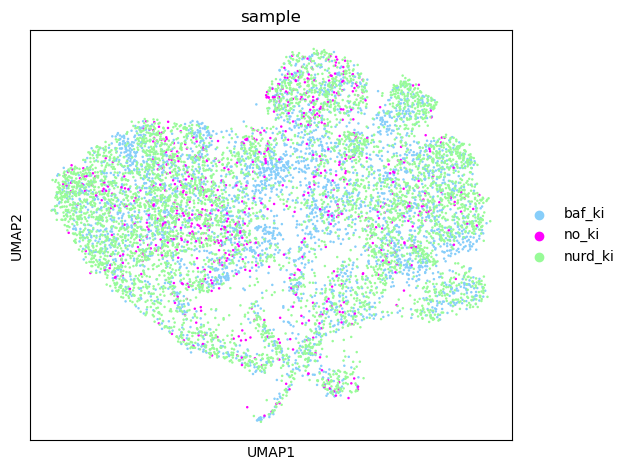

In [284]:
sc.pl.umap(data, color='sample', show=False, size=13)
plt.show()

In [287]:
data.obs.keys()

Index(['bc_wells', 'sample', 'species', 'gene_count', 'tscp_count',
       'mread_count', 'bc1_well', 'bc2_well', 'bc3_well', 'bc1_wind',
       'bc2_wind', 'bc3_wind', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'guide_set', 'guide_set_all',
       't7_umis_removed_counts', 'dosages_removed_counts',
       't7_all_removed_counts', 't7_no_bc_umis_removed_counts', 'mito_perc',
       't7_all', 't7_no_bc_umis', 't7_umis', 'S_score', 'G2M_score', 'phase',
       'leiden', 'leiden_merged'],
      dtype='object')

In [288]:
data.obs['log10_total_counts'] = np.log10(data.obs['total_counts'].values)

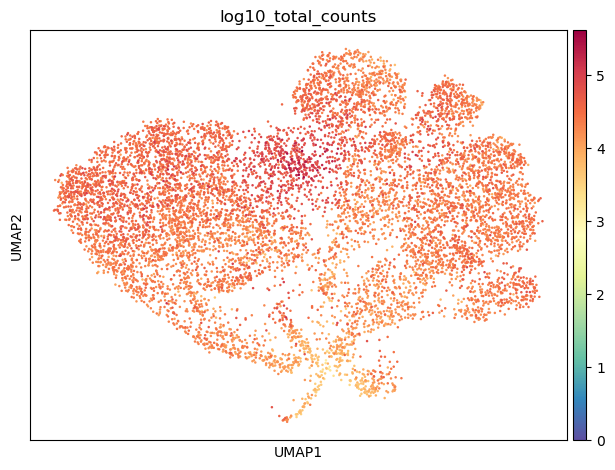

In [293]:
sc.pl.umap(data, color='log10_total_counts', show=False, size=13, cmap='Spectral_r', vmin=0)
plt.show()

In [99]:
!wget https://raw.githubusercontent.com/scverse/scanpy_usage/refs/heads/master/180209_cell_cycle/data/regev_lab_cell_cycle_genes.txt -O {data_dir}regev_lab_cell_cycle_genes.txt

--2024-10-14 13:59:03--  https://raw.githubusercontent.com/scverse/scanpy_usage/refs/heads/master/180209_cell_cycle/data/regev_lab_cell_cycle_genes.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 556 [text/plain]
Saving to: ‘/iblm/netapp/data4/bbalderson/edit_capture/data/t7_allelic_calling/superb_count_all10/combined/regev_lab_cell_cycle_genes.txt’

100%[======================================>] 556         --.-K/s   in 0s      

2024-10-14 13:59:03 (40.2 MB/s) - ‘/iblm/netapp/data4/bbalderson/edit_capture/data/t7_allelic_calling/superb_count_all10/combined/regev_lab_cell_cycle_genes.txt’ saved [556/556]


In [101]:
cycle_genes = [line.strip('\n') for line in open(f"{data_dir}regev_lab_cell_cycle_genes.txt", "r")]
s_genes = cycle_genes[:43]
g2m_genes = cycle_genes[43:]
s_genes, g2m_genes

(['MCM5',
  'PCNA',
  'TYMS',
  'FEN1',
  'MCM2',
  'MCM4',
  'RRM1',
  'UNG',
  'GINS2',
  'MCM6',
  'CDCA7',
  'DTL',
  'PRIM1',
  'UHRF1',
  'MLF1IP',
  'HELLS',
  'RFC2',
  'RPA2',
  'NASP',
  'RAD51AP1',
  'GMNN',
  'WDR76',
  'SLBP',
  'CCNE2',
  'UBR7',
  'POLD3',
  'MSH2',
  'ATAD2',
  'RAD51',
  'RRM2',
  'CDC45',
  'CDC6',
  'EXO1',
  'TIPIN',
  'DSCC1',
  'BLM',
  'CASP8AP2',
  'USP1',
  'CLSPN',
  'POLA1',
  'CHAF1B',
  'BRIP1',
  'E2F8'],
 ['HMGB2',
  'CDK1',
  'NUSAP1',
  'UBE2C',
  'BIRC5',
  'TPX2',
  'TOP2A',
  'NDC80',
  'CKS2',
  'NUF2',
  'CKS1B',
  'MKI67',
  'TMPO',
  'CENPF',
  'TACC3',
  'FAM64A',
  'SMC4',
  'CCNB2',
  'CKAP2L',
  'CKAP2',
  'AURKB',
  'BUB1',
  'KIF11',
  'ANP32E',
  'TUBB4B',
  'GTSE1',
  'KIF20B',
  'HJURP',
  'CDCA3',
  'HN1',
  'CDC20',
  'TTK',
  'CDC25C',
  'KIF2C',
  'RANGAP1',
  'NCAPD2',
  'DLGAP5',
  'CDCA2',
  'CDCA8',
  'ECT2',
  'KIF23',
  'HMMR',
  'AURKA',
  'PSRC1',
  'ANLN',
  'LBR',
  'CKAP5',
  'CENPE',
  'CTCF',
  'NEK2',
 

In [102]:
sc.tl.score_genes_cell_cycle(data, s_genes, g2m_genes)

In [103]:
data.obs.keys()

Index(['bc_wells', 'sample', 'species', 'gene_count', 'tscp_count',
       'mread_count', 'bc1_well', 'bc2_well', 'bc3_well', 'bc1_wind',
       'bc2_wind', 'bc3_wind', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'guide_set', 'guide_set_all',
       't7_umis_removed_counts', 'dosages_removed_counts',
       't7_all_removed_counts', 't7_no_bc_umis_removed_counts', 'mito_perc',
       't7_all', 't7_no_bc_umis', 't7_umis', 'S_score', 'G2M_score', 'phase'],
      dtype='object')

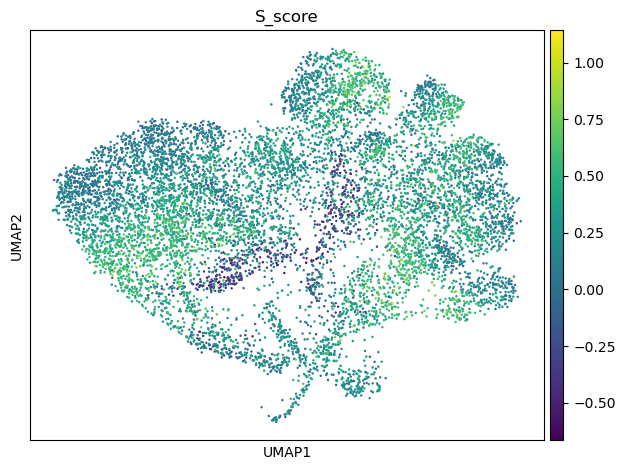

In [231]:
sc.pl.umap(data, color='S_score', show=False)
plt.show()

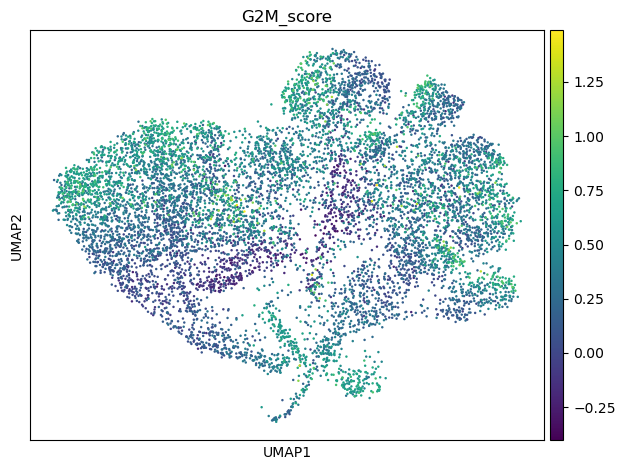

In [232]:
sc.pl.umap(data, color='G2M_score', show=False)
plt.show()

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


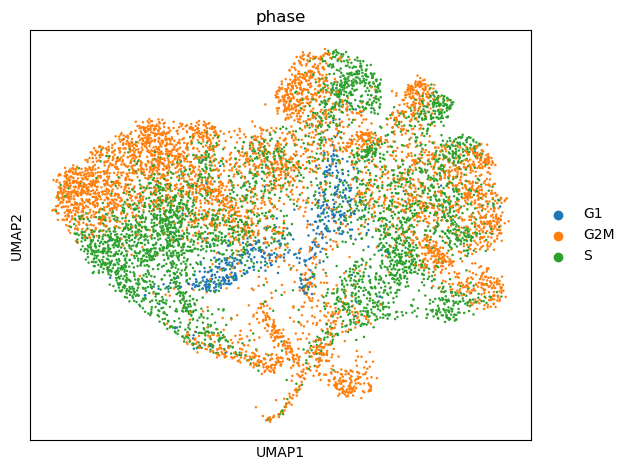

In [233]:
sc.pl.umap(data, color='phase', show=False)
plt.show()

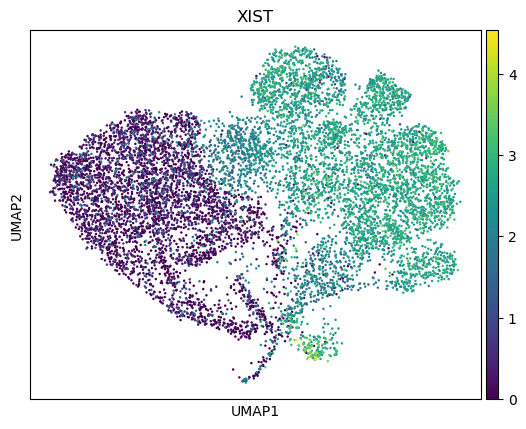

<Figure size 640x480 with 0 Axes>

In [268]:
sc.pl.umap(data, color='XIST')
plt.show()

In [136]:
sc.tl.leiden(data, resolution=1)

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


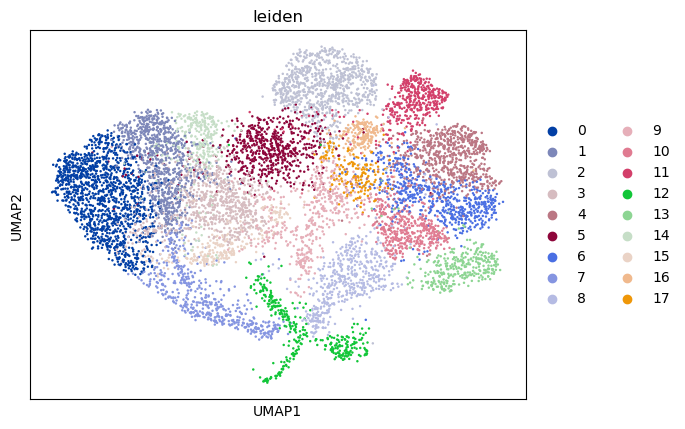

In [137]:
sc.pl.umap(data, color='leiden')

In [ ]:
!pip install cytocipher

In [138]:
import cytocipher as cc

In [139]:
cc.tl.get_markers(data, 'leiden', var_groups='highly_variable')

Added data.uns['leiden_markers']


In [140]:
cc.tl.code_enrich(data, 'leiden', n_cpus=10)

Added data.obsm['leiden_enrich_scores']


/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/cytocipher/plotting/cluster_diagnostics.py:111: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  score_data = sc.AnnData(cell_scores_df, obs=data.obs)


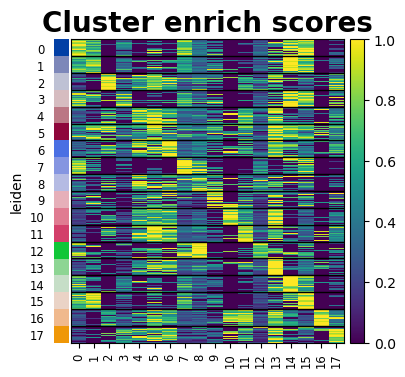

In [141]:
cc.pl.enrich_heatmap(data, 'leiden', figsize=(4,4))

In [168]:
cc.tl.merge_clusters(data, 'leiden', n_cpus=10, p_cut=.01)

Initial merge.
Added data.obs[f'leiden_merged']
Exiting due to reaching max_iter 0


/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/cytocipher/plotting/cluster_diagnostics.py:111: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  score_data = sc.AnnData(cell_scores_df, obs=data.obs)
/iblm/netapp/home/bbalderson/myPython/BeautifulCells/beautifulcells/visualisation/helpers.py:19: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


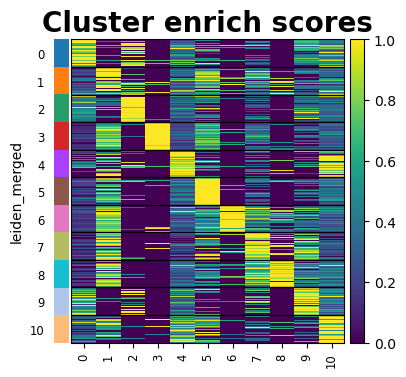

In [182]:
cc.pl.enrich_heatmap(data, 'leiden_merged', figsize=(4,4), scale_cols=True, show=False)
plt.show()

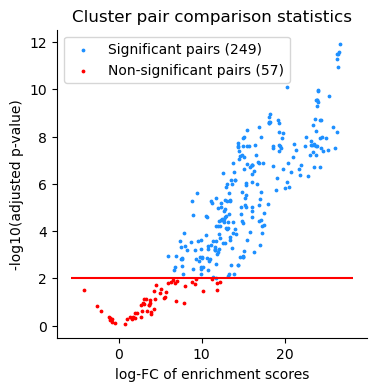

In [170]:
cc.pl.volcano(data, 'leiden', p_cut=.01, p_adjust=True, figsize=(4,4))

In [171]:
#cc.tl.merge(data, 'leiden', 0.01)

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


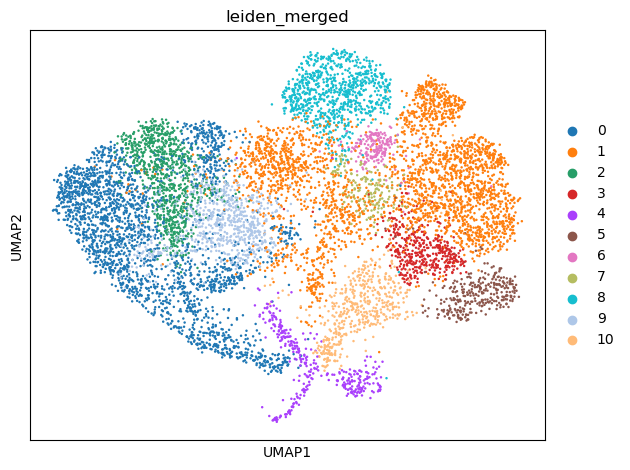

In [181]:
sc.pl.umap(data, color='leiden_merged', show=False)
plt.show()

Printing top and bottom most significant/non-significant clusters.

Top significant
p=3.811346893209116e-15 (16 cells; 16 scores) vs (7 cells; 16 scores)
p=4.730660150878926e-08 (16 cells; 7 scores) vs (7 cells; 7 scores)


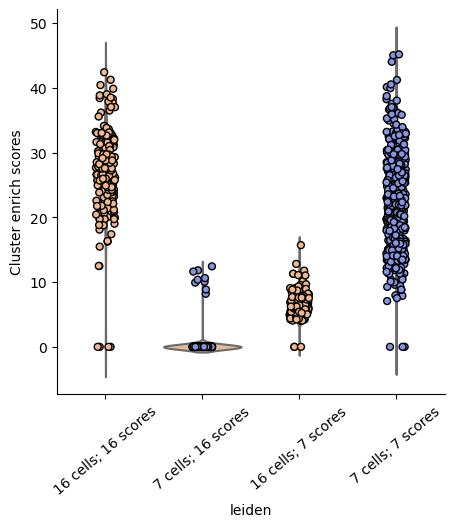

Bottom significant
p=0.8404718643950784 (5 cells; 5 scores) vs (17 cells; 5 scores)
p=2.409014296026419e-06 (5 cells; 17 scores) vs (17 cells; 17 scores)


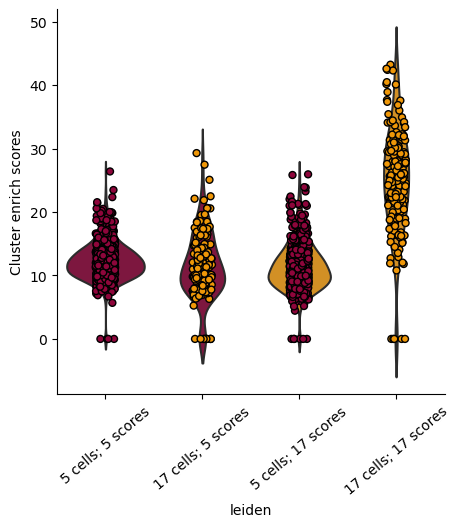

Top non-significant
p=0.5431794376734889 (0 cells; 0 scores) vs (15 cells; 0 scores)
p=0.024671535884460003 (0 cells; 15 scores) vs (15 cells; 15 scores)


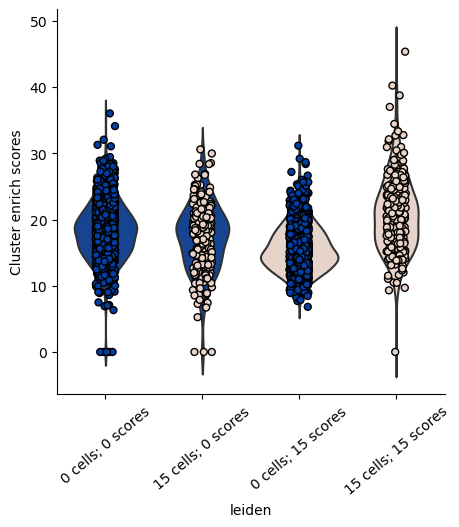

Bottom non-significnat
p=0.00984553470774075 (15 cells; 15 scores) vs (14 cells; 15 scores)
p=0.03427874100450157 (15 cells; 14 scores) vs (14 cells; 14 scores)


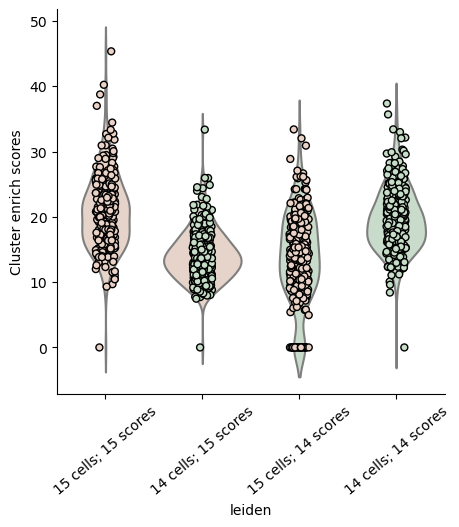

In [173]:
cc.pl.sig_cluster_diagnostics(data, 'leiden')

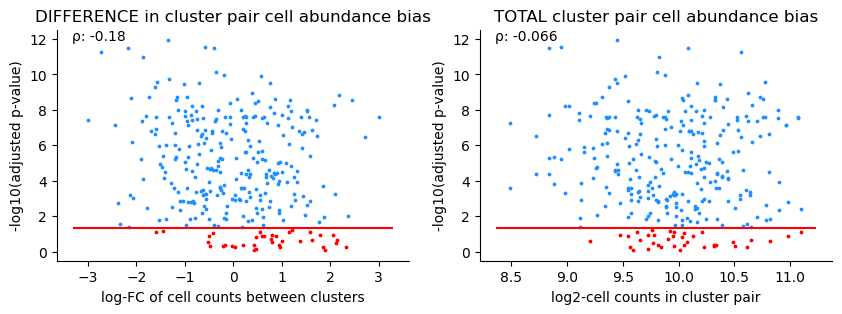

In [174]:
fig, ax = plt.subplots(ncols=2, figsize=(10,3))
cc.pl.check_abundance_bias(data, 'leiden', p_cut=.045, p_adjust=True, show_legend=False, ax=ax[0], show=False)
cc.pl.check_total_abundance_bias(data, 'leiden', p_cut=.045, p_adjust=True, show_legend=False, ax=ax[1], show=False)
plt.show()

In [175]:
markers = data.uns['leiden_merged_markers']
markers

{'0': array(['BLTP2', 'FAM222B', 'SUPT6H', 'NUFIP2', 'RPL23A', 'KIF1A'],
       dtype=object),
 '1': array(['XIST', 'ENSG00000286163', 'ENSG00000259560', 'CCDC26',
        'ENSG00000253642', 'ENSG00000287474'], dtype=object),
 '2': array(['ARHGAP15', 'DOCK8', 'HMGA2', 'LINC02307', 'CFH', 'MUC19'],
       dtype=object),
 '3': array(['CASC15', 'ENSG00000287474', 'XIST', 'LINC00383', 'COBLL1',
        'LINC02055'], dtype=object),
 '4': array(['HSP90AA1', 'NCL', 'HSP90AB1', 'EEF2', 'PTMA', 'NUCKS1'],
       dtype=object),
 '5': array(['XIST', 'ENSG00000249174', 'DDX55', 'LINC02315', 'SCHLAP1',
        'EP400'], dtype=object),
 '6': array(['ENSG00000287474', 'ENSG00000287409', 'XIST', 'LINC02511', 'CECR2',
        'ENSG00000253642'], dtype=object),
 '7': array(['LINC01811', 'PITX1-AS1', 'SLC25A37', 'EPB41', 'CR1L', 'XIST'],
       dtype=object),
 '8': array(['DSCAM', 'ENSG00000259560', 'XIST', 'SH3GL3', 'LINC03077',
        'LINC02770'], dtype=object),
 '9': array(['CR1L', 'SLC25A37', 'ENSG

In [176]:
marker_genes = {key: values[0:2] for key, values in markers.items()}

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


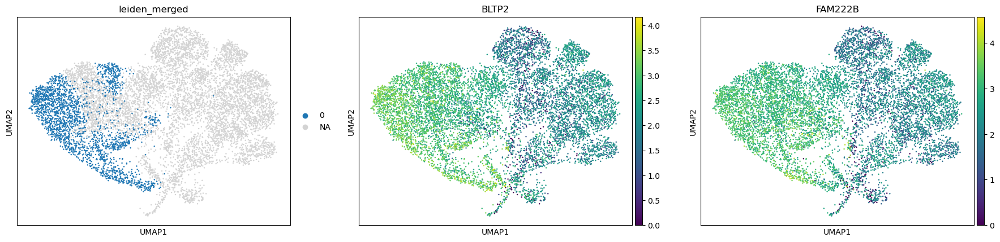

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


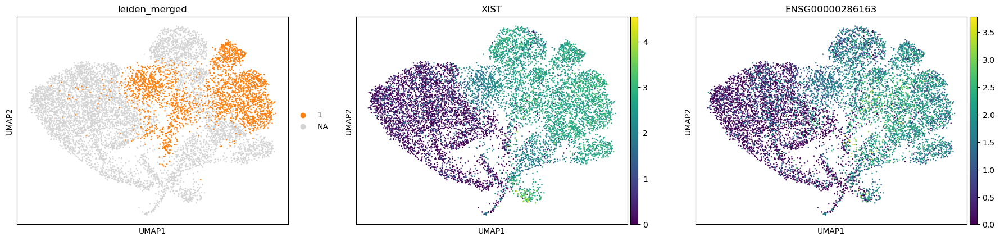

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


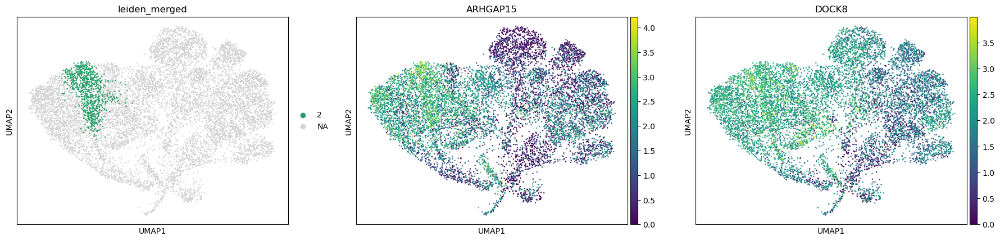

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


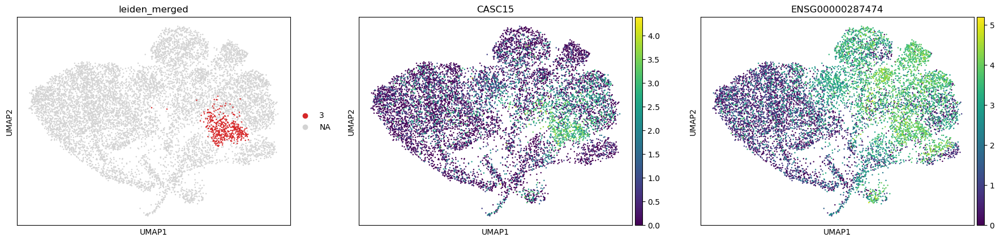

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


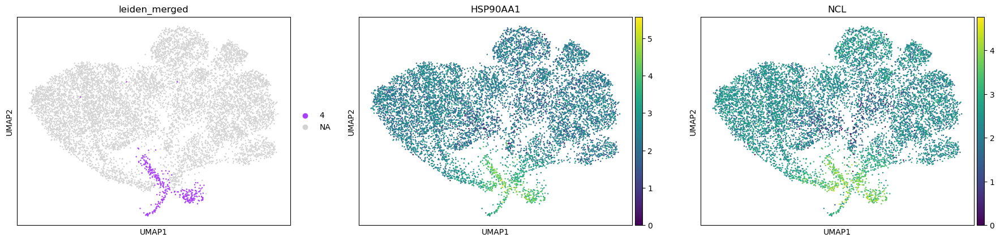

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


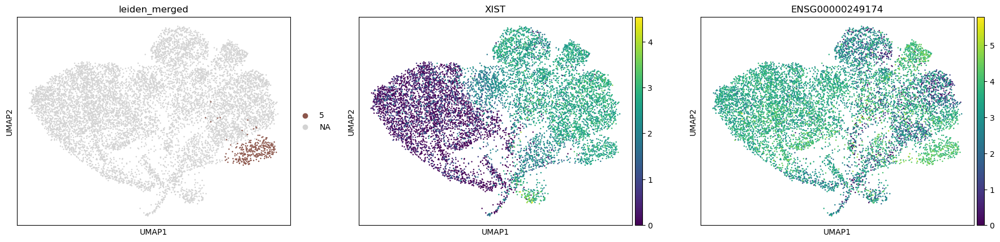

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


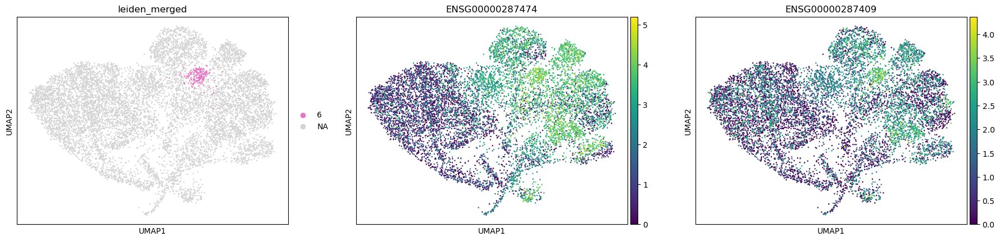

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


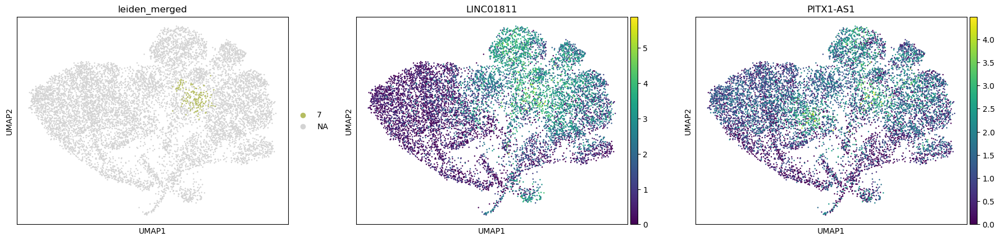

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


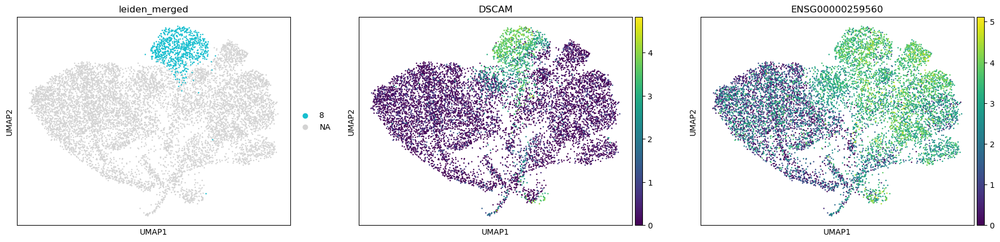

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


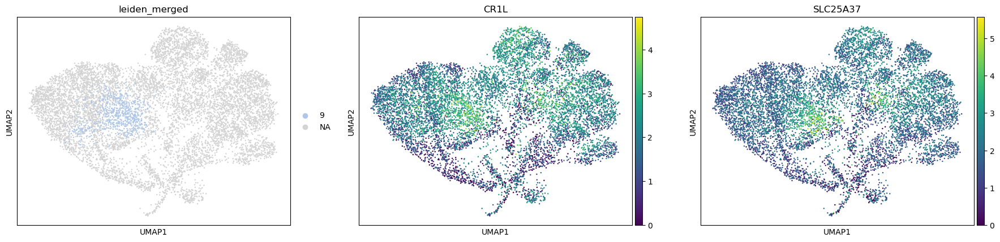

/iblm/netapp/home/bbalderson/miniforge3/envs/rat_multiomics/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


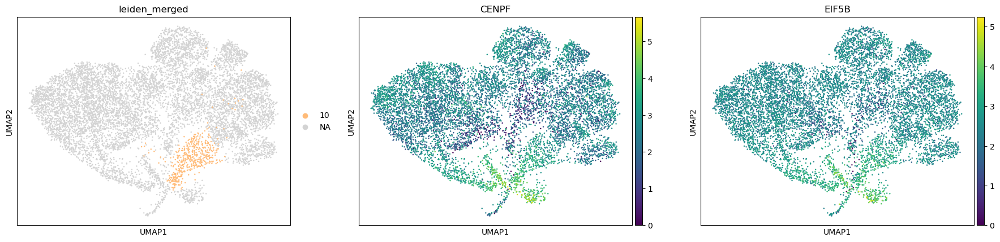

In [177]:
for clust, genes in marker_genes.items():

    sc.pl.umap(data, color=['leiden_merged']+list(genes), groups=[clust])

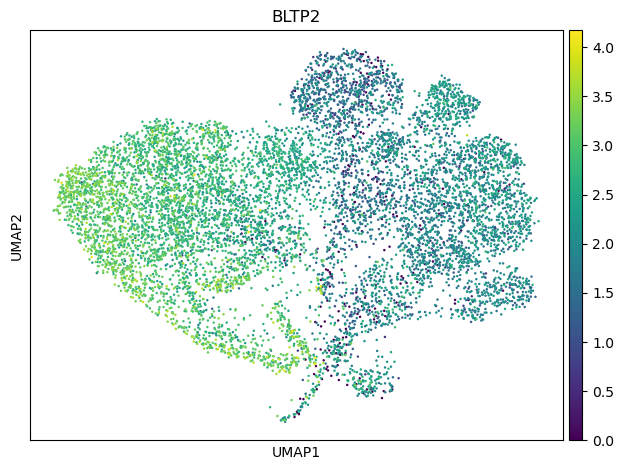

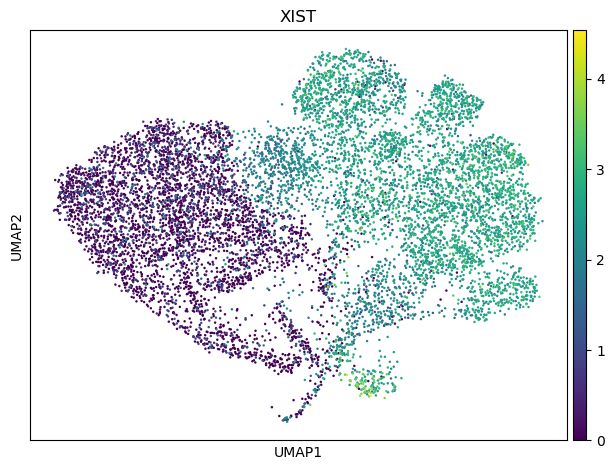

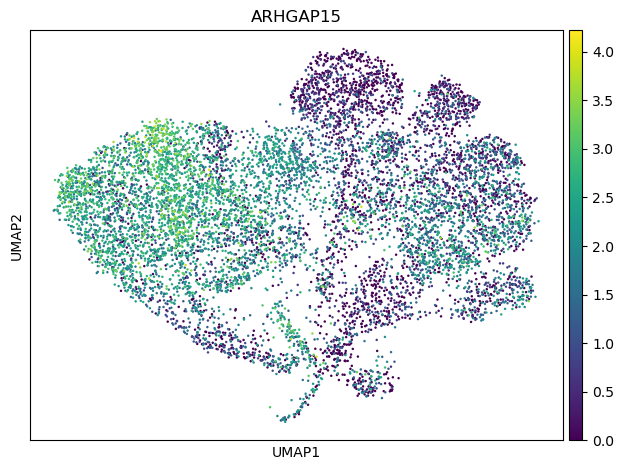

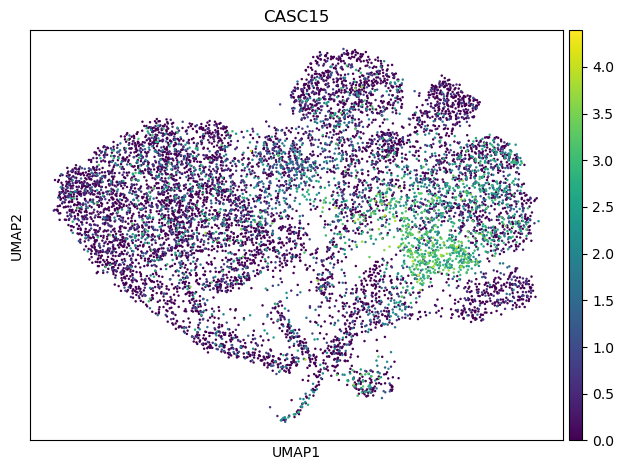

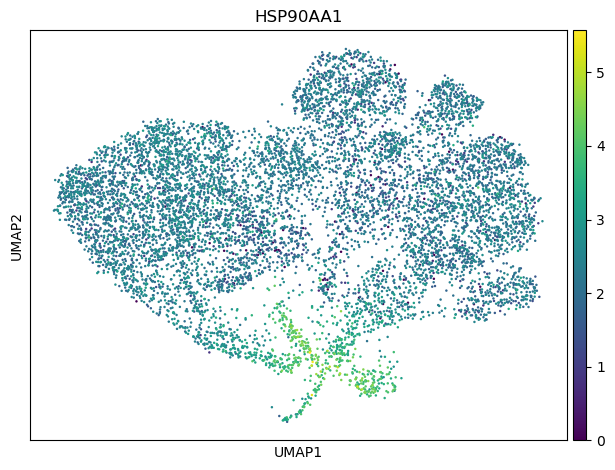

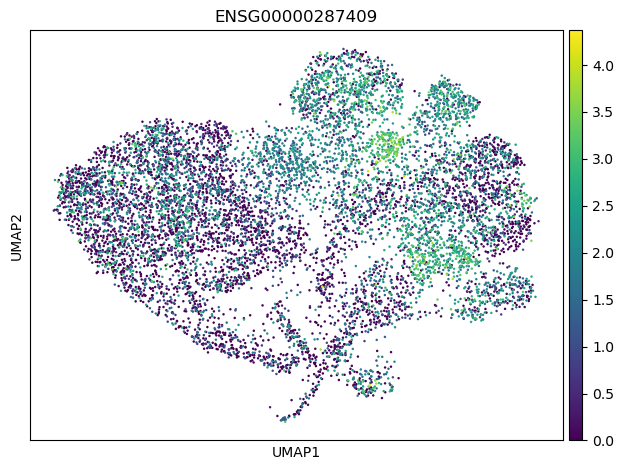

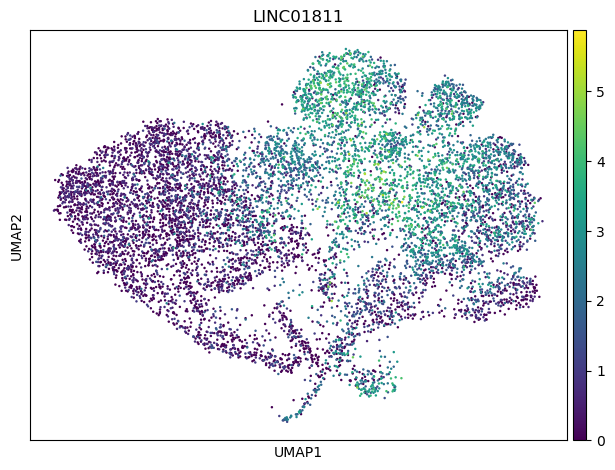

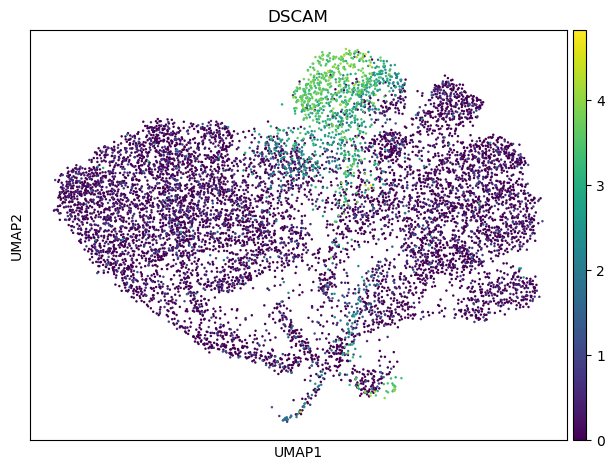

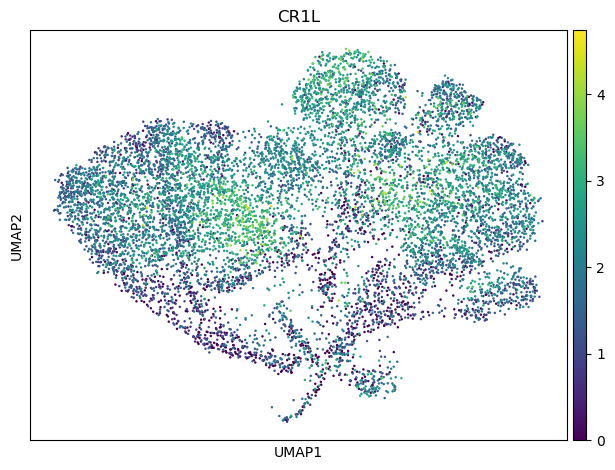

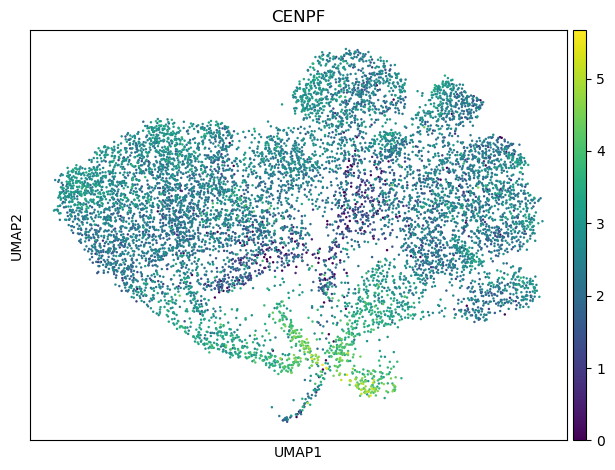

In [273]:
#### Selecting some example genes to save and show in the plot...
select_genes = ['BLTP2', 'XIST', 'ARHGAP15', 'CASC15', 'HSP90AA1', 'ENSG00000287409', 'LINC01811', 'DSCAM',
               'CR1L', 'CENPF']
for gene in select_genes:
    sc.pl.umap(data, color=gene, show=False)
    plt.show()

In [274]:
len(select_genes)

10

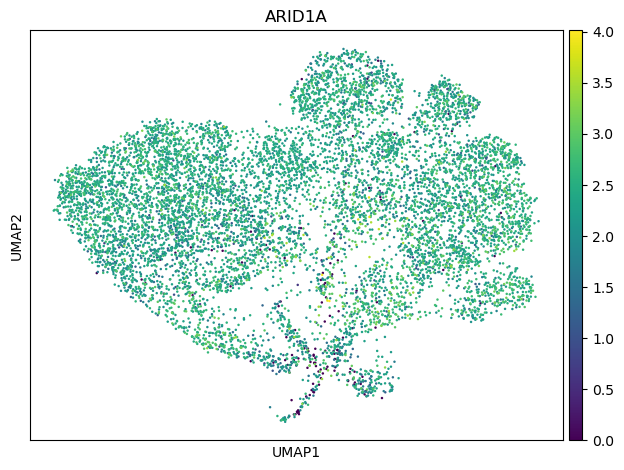

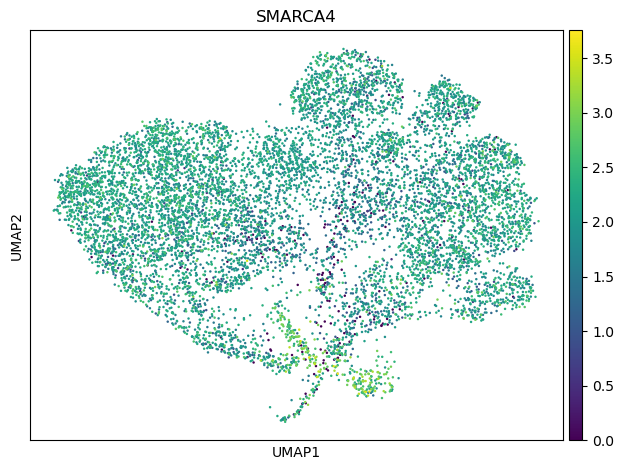

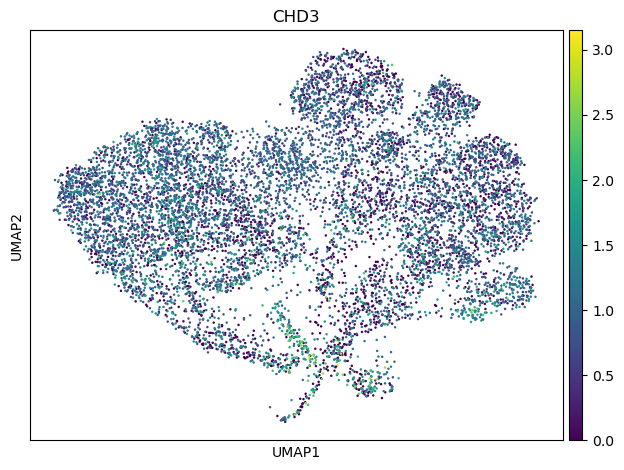

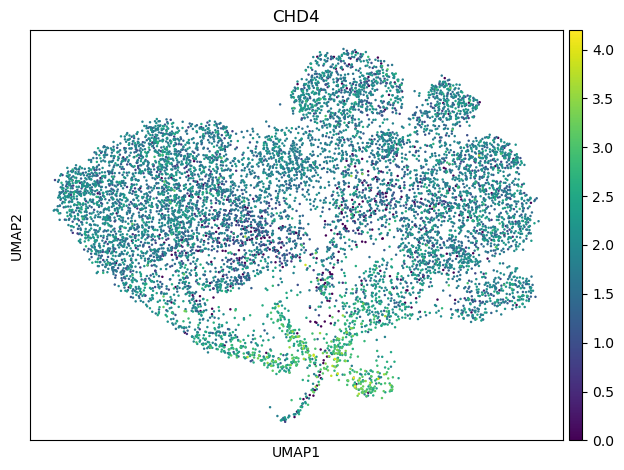

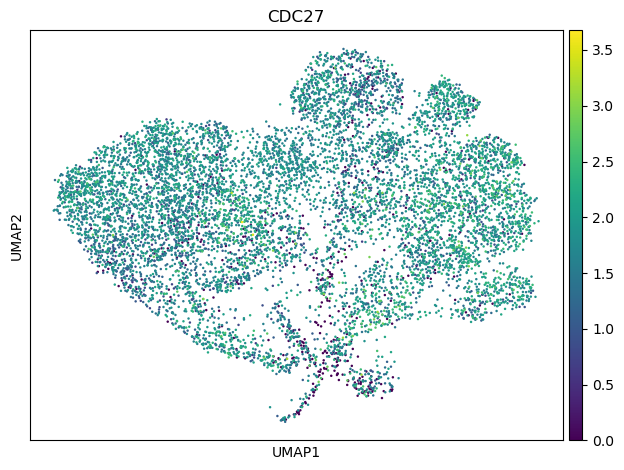

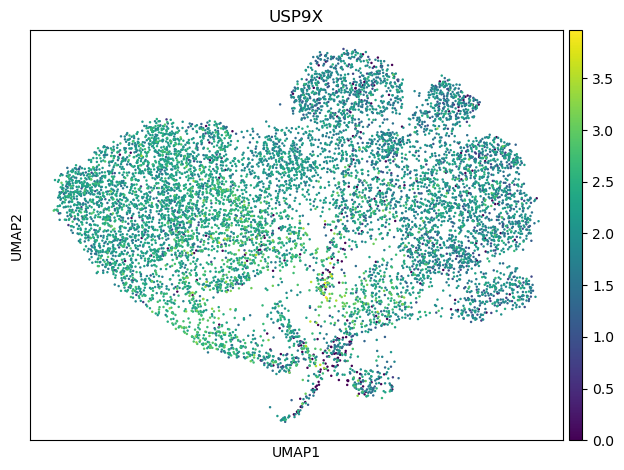

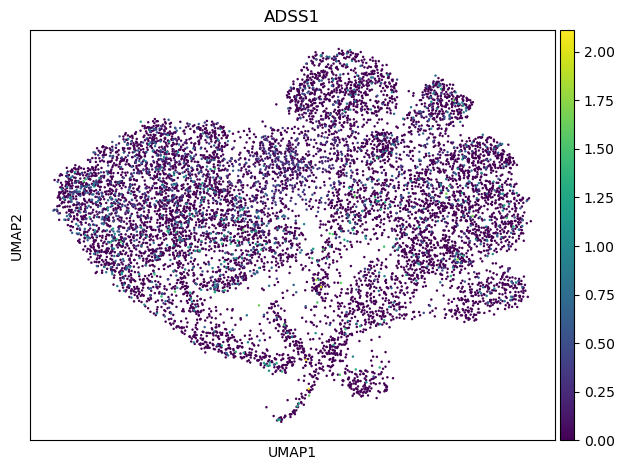

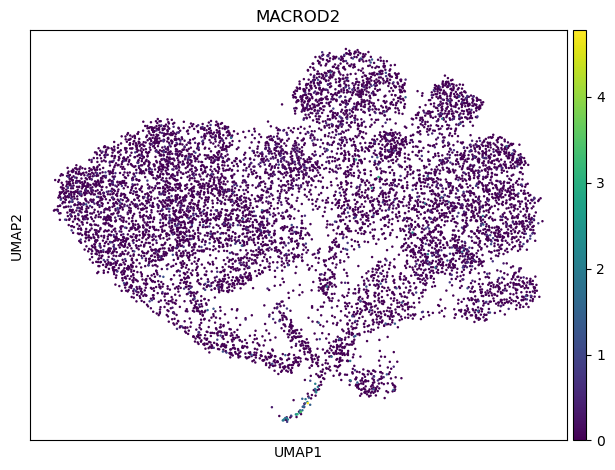

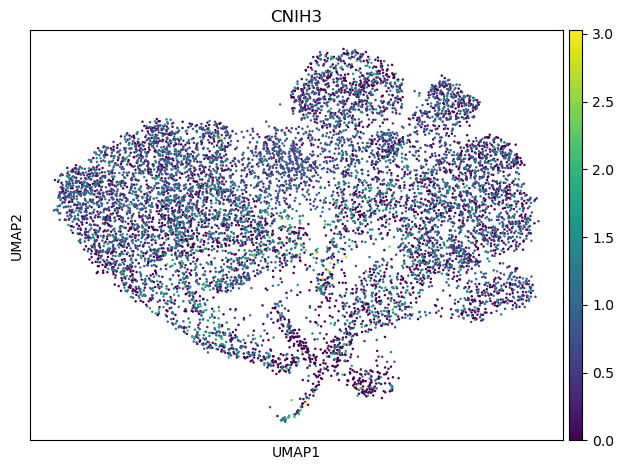

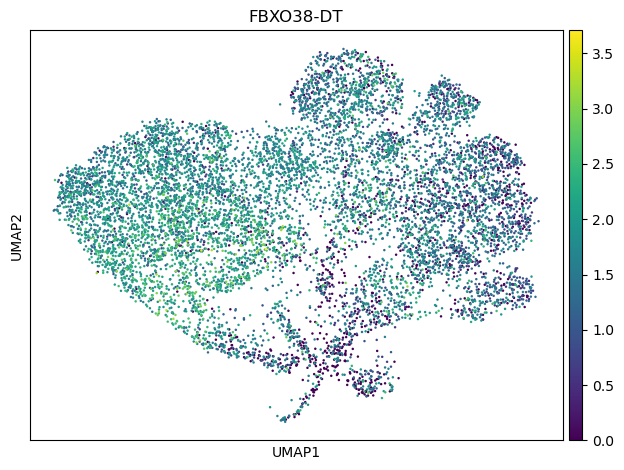

In [531]:
#### Also for the on-target and off-target genes of interest.
perturbed_genes = ['ARID1A', 'SMARCA4', 'CHD3', 'CHD4', 'CDC27', 'USP9X', 'ADSS1', 'MACROD2', 'CNIH3', 'FBXO38-DT']
for gene in perturbed_genes:
    sc.pl.umap(data, color=gene, show=False)
    vhs.dealWithPlot(True, True, True, out_plots, f"{gene}_umap.png", 300)

In [272]:
len(perturbed_genes)

6

In [179]:
data.layers["scaled"] = sc.pp.scale(data, copy=True).X

/iblm/netapp/home/bbalderson/myPython/BeautifulCells/beautifulcells/visualisation/helpers.py:19: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


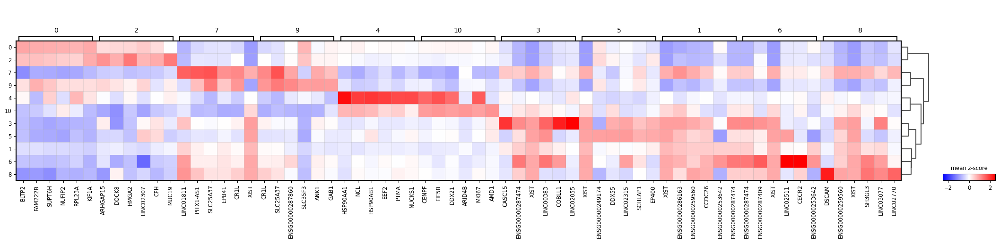

In [187]:
sc.pl.matrixplot(
    data,
    markers,
    "leiden_merged",
    dendrogram=True,
    colorbar_title="mean z-score",
    layer="scaled",
    vmin=-2.5,
    vmax=2.5,
    cmap="bwr", show=False
)
plt.show()

In [192]:
tcfs = [gene for gene in data.var_names if gene.startswith('TCF')]

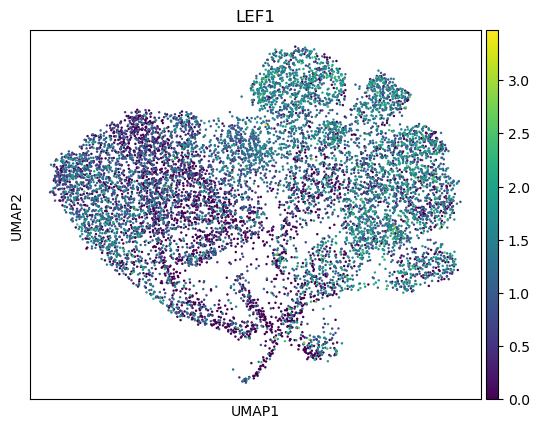

In [191]:
# Looking at WNT co-TFs
sc.pl.umap(data, color='LEF1')

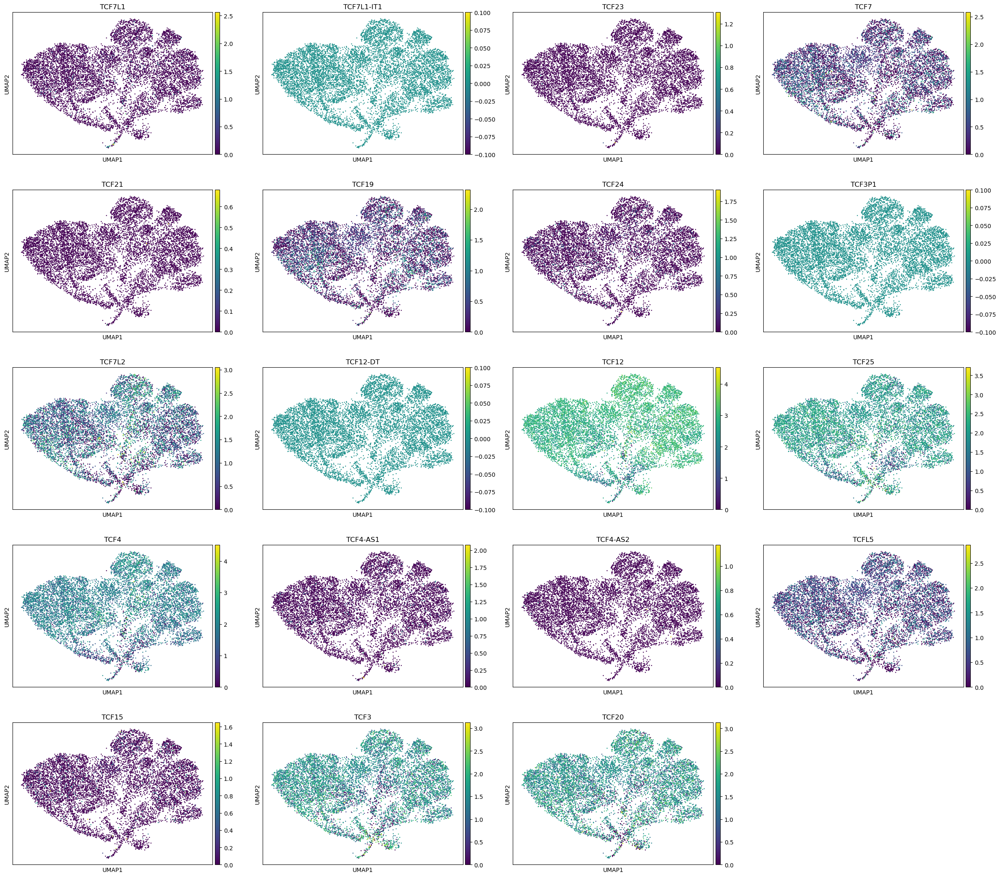

In [193]:
sc.pl.umap(data, color=tcfs)

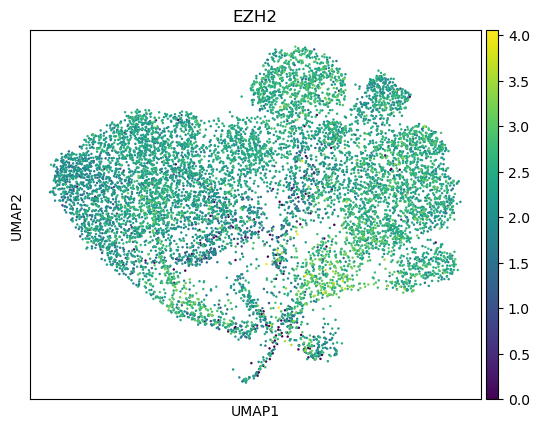

In [194]:
sc.pl.umap(data, color='EZH2')

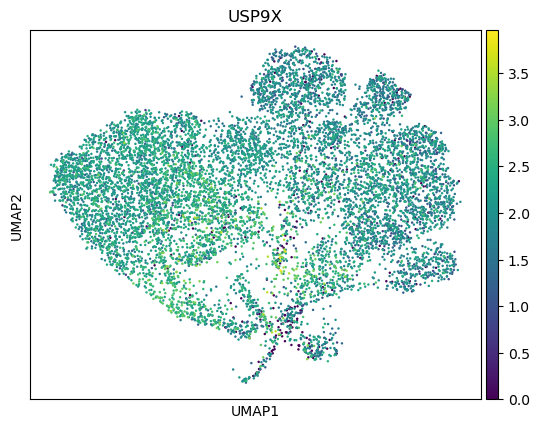

In [195]:
sc.pl.umap(data, color='USP9X')

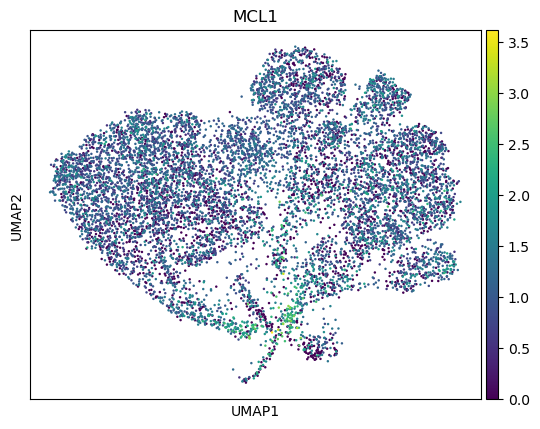

In [196]:
sc.pl.umap(data, color='MCL1')

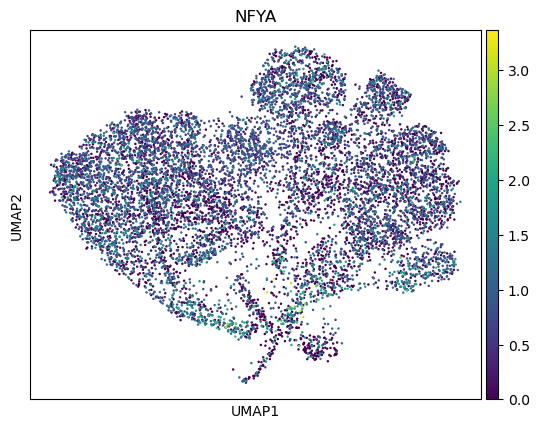

In [197]:
sc.pl.umap(data, color='NFYA')

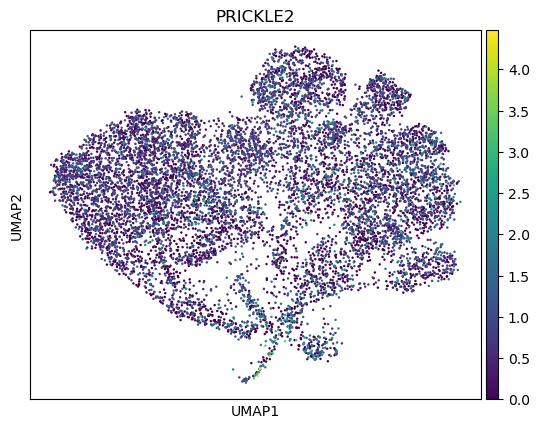

In [199]:
sc.pl.umap(data, color='PRICKLE2')

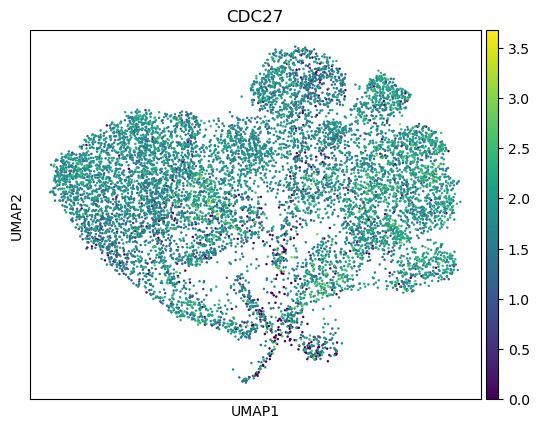

In [207]:
sc.pl.umap(data, color='CDC27')

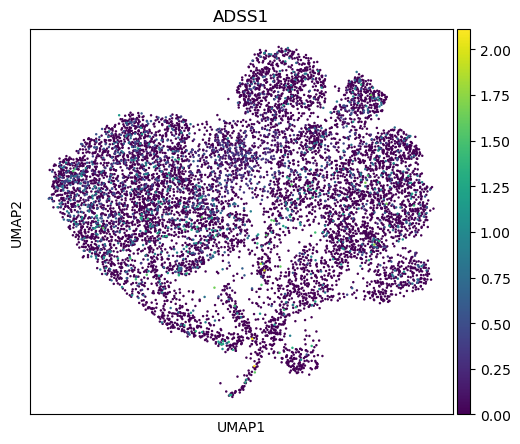

<Figure size 640x480 with 0 Axes>

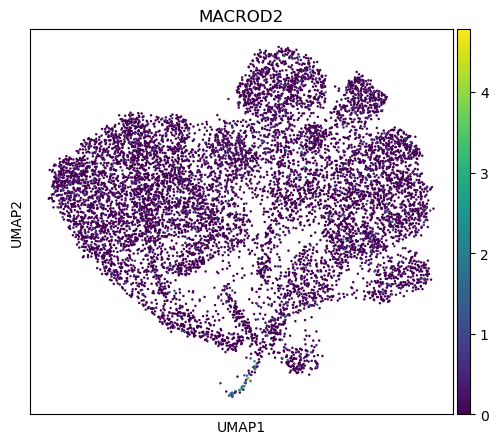

<Figure size 640x480 with 0 Axes>

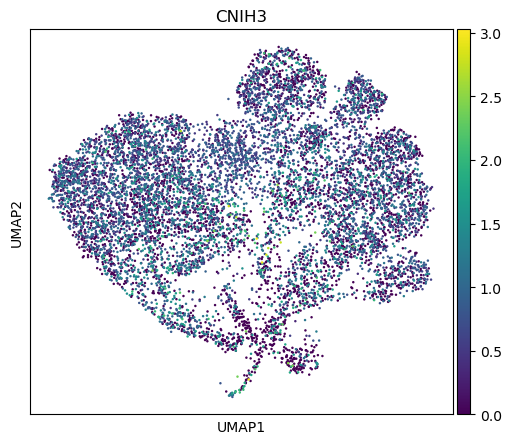

<Figure size 640x480 with 0 Axes>

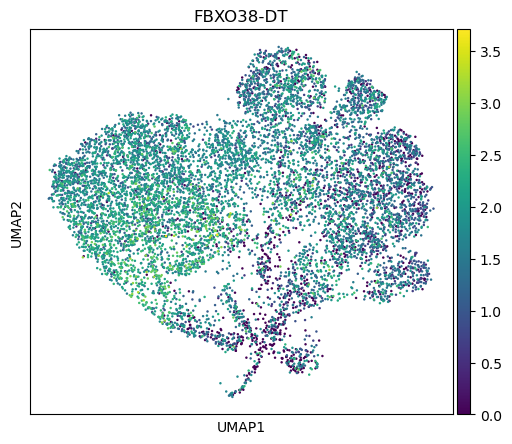

<Figure size 640x480 with 0 Axes>

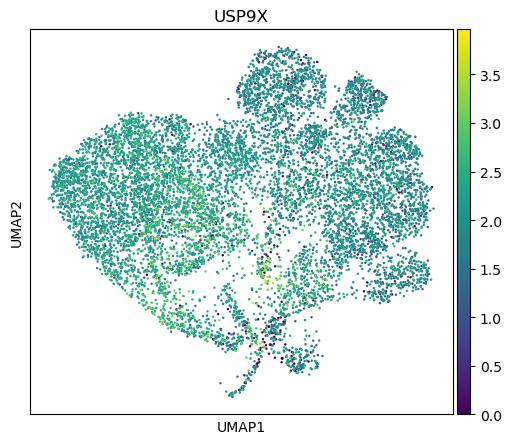

<Figure size 640x480 with 0 Axes>

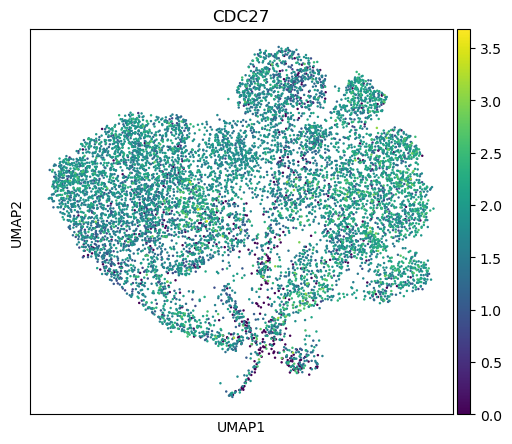

<Figure size 640x480 with 0 Axes>

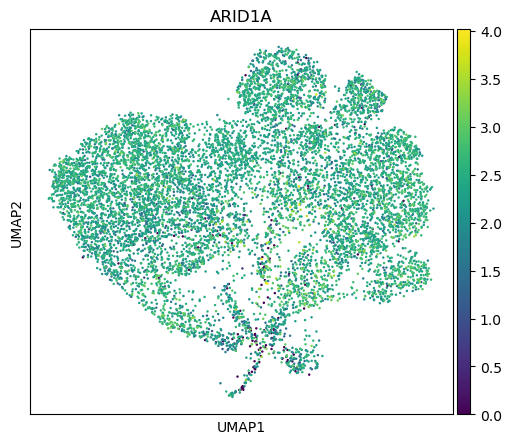

<Figure size 640x480 with 0 Axes>

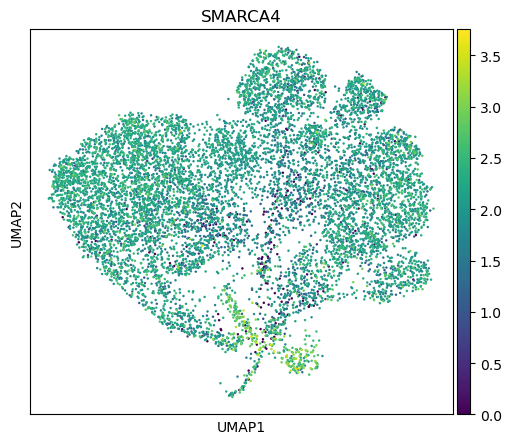

<Figure size 640x480 with 0 Axes>

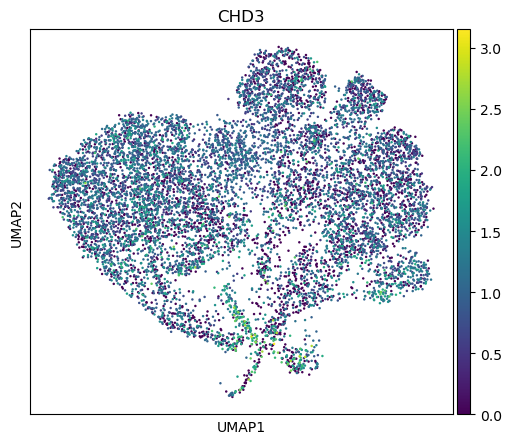

<Figure size 640x480 with 0 Axes>

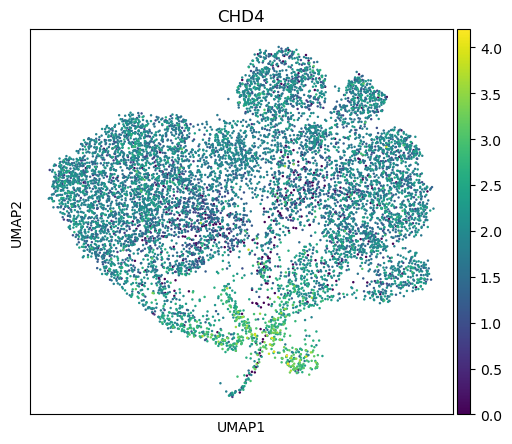

<Figure size 640x480 with 0 Axes>

In [529]:
genes_ = ['ADSS1', 'MACROD2', 'CNIH3', 'FBXO38-DT', 'USP9X', 'CDC27', 'ARID1A', 'SMARCA4', 'CHD3', 'CHD4']
for gene_ in genes_:
    fig, ax = plt.subplots(figsize=(6,5))
    sc.pl.umap(data, color=gene_, ax=ax)
    plt.show()

In [528]:
data.shape

(9500, 62754)

# Saving the cell metadata to add to the GEO entry.

In [721]:
data.obs.columns

Index(['bc_wells', 'sample', 'species', 'gene_count', 'tscp_count',
       'mread_count', 'bc1_well', 'bc2_well', 'bc3_well', 'bc1_wind',
       'bc2_wind', 'bc3_wind', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'guide_set', 'guide_set_all',
       't7_umis_removed_counts', 'dosages_removed_counts',
       't7_all_removed_counts', 't7_no_bc_umis_removed_counts', 'mito_perc',
       't7_all', 't7_no_bc_umis', 't7_umis', 'S_score', 'G2M_score', 'phase',
       'leiden', 'leiden_merged', 'log10_total_counts', 'edit_cell_labels',
       'USP9X_edit_dosages', 'CHD3_edit_dosages', 'CHD4_edit_dosages',
       'ARID1A_edit_dosages', 'SMARCA4_edit_dosages'],
      dtype='object')

In [740]:
keep_cols = ['sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'mito_perc',
       't7_all', 't7_no_bc_umis', 't7_umis', 'S_score', 'G2M_score', 'phase',
       'leiden', 'leiden_merged', 'log10_total_counts', 'edit_cell_labels']

cell_meta = data.obs.loc[:,keep_cols]
cell_meta

,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,mito_perc,t7_all,t7_no_bc_umis,t7_umis,S_score,G2M_score,phase,leiden,leiden_merged,log10_total_counts,edit_cell_labels
bc_wells,,,,,,,,,,,,,,,,,,,,
03_01_02,baf_ki,4758,8.467793,11973,9.390493,10.907876,16.328406,24.070826,38.920905,0.0,7,7,0,0.120508,0.007522,S,2,8,4.078203,no-edit
03_01_06,baf_ki,11356,9.337590,94883,11.460410,9.671912,14.018317,20.327140,32.866794,0.0,48,32,16,0.245107,0.302629,G2M,5,1,4.977188,off-target/s
03_01_30,baf_ki,9682,9.178127,62472,11.042490,12.562428,17.124472,23.725829,36.613203,0.0,99,64,35,-0.133421,0.319470,G2M,11,1,4.795685,"SMARCA4-edit, off-target/s"
03_01_38,baf_ki,9258,9.133351,49417,10.808070,8.845134,13.222171,19.665297,32.594047,0.0,29,22,7,0.309590,0.220401,S,5,1,4.693876,off-target/s
03_01_40,baf_ki,6970,8.849514,27464,10.220668,13.250073,17.987183,24.843431,38.220944,0.0,14,11,3,0.296396,0.484828,G2M,2,8,4.438764,"SMARCA4-edit, off-target/s"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12_95_65,nurd_ki,6239,8.738735,18276,9.813399,7.003721,10.746334,16.797986,30.477128,0.0,5,4,1,0.523616,-0.047127,S,7,0,4.261881,"CHD4-edit, off-target/s"
12_95_66,nurd_ki,7547,8.929038,30619,10.329409,14.592247,19.151507,25.595219,38.244227,0.0,12,9,3,0.072578,0.769809,G2M,6,1,4.485991,"CHD4-edit, off-target/s"
12_95_84,nurd_ki,9003,9.105424,49469,10.809122,12.023692,16.432513,22.796095,35.321110,0.0,14,10,4,0.395040,0.198680,S,4,1,4.694333,"double-edit, off-target/s"


In [741]:
data.obsm.keys()

KeysView(AxisArrays with keys: X_pca, X_umap, dosages, dosages_corrected, dosages_corrected_genes, dosages_corrected_genes_manual-edits-only, dosages_genes, dosages_genes_manual-edits-only, t7_all, t7_all_corrected, t7_no_bc_umis, t7_no_bc_umis_corrected, t7_umis, t7_umis_corrected, leiden_enrich_scores, leiden_merged_enrich_scores)

In [742]:
cell_meta['UMAP_1'] = data.obsm['X_umap'][:,0]
cell_meta['UMAP_2'] = data.obsm['X_umap'][:,1]

cell_meta

,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,mito_perc,...,t7_umis,S_score,G2M_score,phase,leiden,leiden_merged,log10_total_counts,edit_cell_labels,UMAP_1,UMAP_2
bc_wells,,,,,,,,,,,,,,,,,,,,,
03_01_02,baf_ki,4758,8.467793,11973,9.390493,10.907876,16.328406,24.070826,38.920905,0.0,...,0,0.120508,0.007522,S,2,8,4.078203,no-edit,7.432837,14.043379
03_01_06,baf_ki,11356,9.337590,94883,11.460410,9.671912,14.018317,20.327140,32.866794,0.0,...,16,0.245107,0.302629,G2M,5,1,4.977188,off-target/s,4.087674,11.223516
03_01_30,baf_ki,9682,9.178127,62472,11.042490,12.562428,17.124472,23.725829,36.613203,0.0,...,35,-0.133421,0.319470,G2M,11,1,4.795685,"SMARCA4-edit, off-target/s",8.531161,11.902770
03_01_38,baf_ki,9258,9.133351,49417,10.808070,8.845134,13.222171,19.665297,32.594047,0.0,...,7,0.309590,0.220401,S,5,1,4.693876,off-target/s,4.791344,12.127399
03_01_40,baf_ki,6970,8.849514,27464,10.220668,13.250073,17.987183,24.843431,38.220944,0.0,...,3,0.296396,0.484828,G2M,2,8,4.438764,"SMARCA4-edit, off-target/s",6.143662,13.619011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12_95_65,nurd_ki,6239,8.738735,18276,9.813399,7.003721,10.746334,16.797986,30.477128,0.0,...,1,0.523616,-0.047127,S,7,0,4.261881,"CHD4-edit, off-target/s",1.663564,4.251138
12_95_66,nurd_ki,7547,8.929038,30619,10.329409,14.592247,19.151507,25.595219,38.244227,0.0,...,3,0.072578,0.769809,G2M,6,1,4.485991,"CHD4-edit, off-target/s",8.641739,9.829327
12_95_84,nurd_ki,9003,9.105424,49469,10.809122,12.023692,16.432513,22.796095,35.321110,0.0,...,4,0.395040,0.198680,S,4,1,4.694333,"double-edit, off-target/s",10.680959,11.276278


In [743]:
out_dir

'/iblm/netapp/data4/bbalderson/edit_capture/data/t7_allelic_calling/superb_count_all10/combined/cell_qc_tables/'

In [744]:
?cell_meta.to_csv

Signature:
cell_meta.to_csv(
    path_or_buf: 'FilePath | WriteBuffer[bytes] | WriteBuffer[str] | None' = None,
    sep: 'str' = ',',
    na_rep: 'str' = '',
    float_format: 'str | Callable | None' = None,
    columns: 'Sequence[Hashable] | None' = None,
    header: 'bool_t | list[str]' = True,
    index: 'bool_t' = True,
    index_label: 'IndexLabel | None' = None,
    mode: 'str' = 'w',
    encoding: 'str | None' = None,
    compression: 'CompressionOptions' = 'infer',
    quoting: 'int | None' = None,
    quotechar: 'str' = '"',
    lineterminator: 'str | None' = None,
    chunksize: 'int | None' = None,
    date_format: 'str | None' = None,
    doublequote: 'bool_t' = True,
    escapechar: 'str | None' = None,
    decimal: 'str' = '.',
    errors: 'str' = 'strict',
    storage_options: 'StorageOptions' = None,
) -> 'str | None'
Docstring:
Write object to a comma-separated values (csv) file.

Parameters
----------
path_or_buf : str, path object, file-like object, or None, default 

In [745]:
cell_meta.to_csv(f'{out_dir}cell_metadata_10k.tsv.gz', sep='\t')

In [747]:
print( f'{out_dir}cell_metadata_10k.tsv.gz' )

/iblm/netapp/data4/bbalderson/edit_capture/data/t7_allelic_calling/superb_count_all10/combined/cell_qc_tables/cell_metadata_10k.tsv.gz


In [746]:
!zcat {out_dir}cell_metadata_10k.tsv.gz | head

bc_wells	sample	n_genes_by_counts	log1p_n_genes_by_counts	total_counts	log1p_total_counts	pct_counts_in_top_50_genes	pct_counts_in_top_100_genes	pct_counts_in_top_200_genes	pct_counts_in_top_500_genes	mito_perc	t7_all	t7_no_bc_umis	t7_umis	S_score	G2M_score	phase	leiden	leiden_merged	log10_total_counts	edit_cell_labels	UMAP_1	UMAP_2
03_01_02	baf_ki	4758	8.46779284112111	11973	9.390492911485298	10.907876054455858	16.32840557921991	24.07082602522342	38.92090537041677	0.0	7	7	0	0.12050827304654221	0.007522311586081076	S	2	8	4.078202982503686	no-edit	7.432837	14.043379
03_01_06	baf_ki	11356	9.337589572891646	94883	11.460410371858927	9.671911722858678	14.01831729603828	20.327139740522536	32.866793840835555	0.0	48	32	16	0.24510714408435175	0.3026294271381914	G2M	5	1	4.977188407711253	off-target/s	4.087674	11.223516
03_01_30	baf_ki	9682	9.17812704961153	62472	11.04248974238561	12.562427967729542	17.12447176334998	23.725829171468817	36.61320271481624	0.0	99	64	35	-0.13342093224178253	0.3194701

***Now the edit_site_info metadata!!!***

In [748]:
data.uns.keys()

dict_keys(['edit_site_info', 'edit_site_info_all_guide_homology', 'edit_site_info_guide_homology', 'edit_site_info_guide_homology_and_coinc', 'edit_site_info_guide_homology_and_coinc_final', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'sample_colors', 'phase_colors', 'leiden', 'rank_genes_groups', 'leiden_colors', 'leiden_markers', 'leiden_neighbours', 'leiden_neighdists', 'leiden_ps', 'leiden_padjs', 'leiden_mutualpairs', 'leiden_merged_markers', 'leiden_merged_colors', 'dendrogram_leiden_merged', 'annot_overlaps', 'edit_cell_labels_colors', 'USP9X_edit_dosages_colors', 'annot_overlap'])

In [756]:
data.obsm.keys()

KeysView(AxisArrays with keys: X_pca, X_umap, dosages, dosages_corrected, dosages_corrected_genes, dosages_corrected_genes_manual-edits-only, dosages_genes, dosages_genes_manual-edits-only, t7_all, t7_all_corrected, t7_no_bc_umis, t7_no_bc_umis_corrected, t7_umis, t7_umis_corrected, leiden_enrich_scores, leiden_merged_enrich_scores)

In [796]:
site_specific_umi_count = data.obsm['t7_umis'].sum(axis=0).reset_index()
site_specific_umi_count.index = site_specific_umi_count['index']
site_specific_umi_count.columns = ['index', 't7_barcoded_umis']
site_specific_umi_count

,index,t7_barcoded_umis
index,,
hg38_1:26696719,hg38_1:26696719,428
hg38_1:224544957,hg38_1:224544957,177
hg38_1:26696862,hg38_1:26696862,120
hg38_1:108747053,hg38_1:108747053,7
hg38_1:245947392,hg38_1:245947392,7
...,...,...
hg38_8:47862492,hg38_8:47862492,4
hg38_9:113111494,hg38_9:113111494,20
hg38_9:37594631,hg38_9:37594631,5


In [797]:
site_specific_umi_count

,index,t7_barcoded_umis
index,,
hg38_1:26696719,hg38_1:26696719,428
hg38_1:224544957,hg38_1:224544957,177
hg38_1:26696862,hg38_1:26696862,120
hg38_1:108747053,hg38_1:108747053,7
hg38_1:245947392,hg38_1:245947392,7
...,...,...
hg38_8:47862492,hg38_8:47862492,4
hg38_9:113111494,hg38_9:113111494,20
hg38_9:37594631,hg38_9:37594631,5


In [799]:
t7_umis = data.obsm['t7_umis']

site_specific_mean_umis = []
for i, edit_site in enumerate(t7_umis.columns):

    edit_site_counts = t7_umis.values[:,i]
    nonzero_bool = edit_site_counts > 0

    mean_ = np.mean( edit_site_counts[nonzero_bool] )
    site_specific_mean_umis.append( mean_ )

In [800]:
site_specific_umi_count.loc[t7_umis.columns.values, 't7_barcoded_umis_per_edited_cell'] = site_specific_mean_umis

In [801]:
site_specific_umi_count

,index,t7_barcoded_umis,t7_barcoded_umis_per_edited_cell
index,,,
hg38_1:26696719,hg38_1:26696719,428,1.192201
hg38_1:224544957,hg38_1:224544957,177,1.291971
hg38_1:26696862,hg38_1:26696862,120,1.176471
hg38_1:108747053,hg38_1:108747053,7,1.400000
hg38_1:245947392,hg38_1:245947392,7,1.000000
...,...,...,...
hg38_8:47862492,hg38_8:47862492,4,1.000000
hg38_9:113111494,hg38_9:113111494,20,1.428571
hg38_9:37594631,hg38_9:37594631,5,1.000000


In [802]:
edit_site_info = data.uns['edit_site_info_guide_homology_and_coinc_final']
edit_site_info.columns

Index(['name', 'chr', 'pos', 'start_window', 'end_window',
       'intersecting_genes', 'copy-number', 'n_cells_edited',
       'stranded_edit_dist', 'target_name', 'target_start', 'target_end',
       'target_seq', 'target_pam', 'strand', 'offset', 'abs_offset',
       'homol_guide_name', 'homol_guide_seq', 'homol_guide_pam', 'target_aln',
       'guide_aln', 'hamming_aln_distance', 'hamming_aln_indel_corrected',
       'match_aln_count', 'coinc_guide_name', 'coinc_guide_seq', 'coinc_count',
       'coinc_fraction', 'guide_score', 'confident_guide_call',
       'manual_edit_call', 't7_umis_removed_counts', 'dosages_removed_counts',
       't7_all_removed_counts', 't7_no_bc_umis_removed_counts'],
      dtype='object')

In [803]:
site_specific_umi_count = site_specific_umi_count.loc[edit_site_info.index.values]

In [804]:
edit_site_info.index

Index(['hg38_1:26696719', 'hg38_1:26696862', 'hg38_12:6602172',
       'hg38_12:6606340', 'hg38_19:10986490', 'hg38_19:10984175',
       'hg38_17:7890653', 'hg38_21:37649273', 'hg38_19:6212712',
       'hg38_6:1397192', 'hg38_X:41086519', 'hg38_20:14937204',
       'hg38_18:3115881', 'hg38_4:14359416', 'hg38_13:34520796',
       'hg38_12:68620881', 'hg38_1:11841677', 'hg38_9:37594631',
       'hg38_1:245947392', 'hg38_10:93632366', 'hg38_3:25497711',
       'hg38_3:194003698', 'hg38_3:31532824', 'hg38_4:79849103',
       'hg38_4:88368039', 'hg38_6:57807628', 'hg38_1:108747053',
       'hg38_1:224544957', 'hg38_11:70522075', 'hg38_16:81393308',
       'hg38_19:10293417', 'hg38_14:104729499', 'hg38_17:47188686',
       'hg38_4:59298822', 'hg38_12:110404170', 'hg38_5:148237295',
       'hg38_13:110873574', 'hg38_17:3029640', 'hg38_9:113111494',
       'hg38_11:68841673', 'hg38_6:67885109', 'hg38_13:113608067',
       'hg38_6:16262954', 'hg38_6:140374836', 'hg38_15:34382827',
       'hg38_

In [805]:
site_specific_umi_count.index.values == edit_site_info.index.values

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True])

In [806]:
keep_cols = ['name', 'chr', 'pos', 'start_window', 'end_window',
       'intersecting_genes', 'copy-number', 'n_cells_edited',
       'stranded_edit_dist', 'target_name', 'target_start', 'target_end',
       'target_seq', 'target_pam', 'strand', 'offset', 'abs_offset',
       'homol_guide_name', 'homol_guide_seq', 'homol_guide_pam', 'target_aln',
       'guide_aln', 'hamming_aln_distance', 'hamming_aln_indel_corrected',
       'match_aln_count', 'coinc_guide_name', 'coinc_guide_seq', 'coinc_count',
       'coinc_fraction', 'guide_score', 'confident_guide_call',
       'manual_edit_call']

edit_site_info_sub = edit_site_info.loc[:, keep_cols]
edit_site_info_sub['t7_barcoded_umis'] = site_specific_umi_count['t7_barcoded_umis'].values
edit_site_info_sub['t7_barcoded_umis_per_edited_cell'] = site_specific_umi_count['t7_barcoded_umis_per_edited_cell'].values
edit_site_info_sub

,name,chr,pos,start_window,end_window,intersecting_genes,copy-number,n_cells_edited,stranded_edit_dist,target_name,...,match_aln_count,coinc_guide_name,coinc_guide_seq,coinc_count,coinc_fraction,guide_score,confident_guide_call,manual_edit_call,t7_barcoded_umis,t7_barcoded_umis_per_edited_cell
hg38_1:26696719,hg38_1:26696719,1,26696719,26696579,26696859,ARID1A,4,359,0,hg38_1:26696719_2,...,20,ARID1A g05,AAGAACTCGAACGGGAACGCGGG,1.000000,0.754789,17.835997,True,True,428,1.192201
hg38_1:26696862,hg38_1:26696862,1,26696862,26696722,26697002,ARID1A,4,102,2,hg38_1:26696862_3,...,20,ARID1A g06,GCTTCGGGCAACCCTACGGCCGG,1.000000,0.900261,18.043814,True,True,120,1.176471
hg38_12:6602172,hg38_12:6602172,12,6602172,6602032,6602312,"ENSG00000285238,CHD4",2,2725,0,hg38_12:6602172_1,...,20,CHD4 g14,GCCGGCATAAGAGCATACGCTGG,1.000000,0.806920,17.910470,True,True,11378,4.175413
hg38_12:6606340,hg38_12:6606340,12,6606340,6606200,6606480,"ENSG00000285238,CHD4",2,179,0,hg38_12:6606340_3,...,20,CHD4 g12,CCTCACTGCCCGCCGAGCAGGGG,1.000000,0.919930,18.071912,True,True,198,1.106145
hg38_19:10986490,hg38_19:10986490,19,10986490,10986350,10986630,SMARCA4,3,52,3,hg38_19:10986490_1,...,20,SMARCA4 g22,ACCGAGGGTGGAGGTAGCGTTGG,1.000000,0.880784,18.015990,True,True,54,1.038462
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
hg38_19:3406603,hg38_19:3406603,19,3406603,3406463,3406743,NFIC,3,3,2,hg38_19:3406603_2,...,9,CHD4 g12,CCTCACTGCCCGCCGAGCAGGGG,0.036515,0.860227,0.234942,False,False,3,1.000000
hg38_10:73387744,hg38_10:73387744,10,73387744,73387604,73387884,ANXA7,4,3,9,hg38_10:73387744_1,...,12,CHD4 g14,GCCGGCATAAGAGCATACGCTGG,0.005002,0.744555,0.171024,False,False,3,1.000000
hg38_7:155680729,hg38_7:155680729,7,155680729,155680589,155680869,RBM33,5,9,1,hg38_7:155680729_3,...,10,ARID1A g05,AAGAACTCGAACGGGAACGCGGG,0.047298,0.312443,-0.536312,False,False,10,1.111111
hg38_17:64502467,hg38_17:64502467,17,64502467,64502327,64502607,DDX5,3,5,9,hg38_17:64502467_1,...,5,ARID1A g06,GCTTCGGGCAACCCTACGGCCGG,0.033520,0.395990,-0.434283,False,False,5,1.000000


In [807]:
out_dir

'/iblm/netapp/data4/bbalderson/edit_capture/data/t7_allelic_calling/superb_count_all10/combined/cell_qc_tables/'

In [808]:
edit_site_info_sub.to_csv(f'{out_dir}edit_site_metadata_10k_cell.tsv', sep='\t', index=False)

In [809]:
print( f'{out_dir}edit_site_metadata_10k_cell.tsv' )

/iblm/netapp/data4/bbalderson/edit_capture/data/t7_allelic_calling/superb_count_all10/combined/cell_qc_tables/edit_site_metadata_10k_cell.tsv


In [810]:
!head {out_dir}edit_site_metadata_10k_cell.tsv

name	chr	pos	start_window	end_window	intersecting_genes	copy-number	n_cells_edited	stranded_edit_dist	target_name	target_start	target_end	target_seq	target_pam	strand	offset	abs_offset	homol_guide_name	homol_guide_seq	homol_guide_pam	target_aln	guide_aln	hamming_aln_distance	hamming_aln_indel_corrected	match_aln_count	coinc_guide_name	coinc_guide_seq	coinc_count	coinc_fraction	guide_score	confident_guide_call	manual_edit_call	t7_barcoded_umis	t7_barcoded_umis_per_edited_cell
hg38_1:26696719	1	26696719	26696579	26696859	ARID1A	4	359	0	hg38_1:26696719_2	26696703	26696726	AAGAACTCGAACGGGAACGCGGG	GGG	+	1	1	ARID1A g05	AAGAACTCGAACGGGAACGC	GGG	AAGAACTCGAACGGGAACGC	AAGAACTCGAACGGGAACGC	0	0	20	ARID1A g05	AAGAACTCGAACGGGAACGCGGG	1.0	0.7547892066073458	17.83599692896594	True	True	428	1.192200557103064
hg38_1:26696862	1	26696862	26696722	26697002	ARID1A	4	102	2	hg38_1:26696862_3	26696848	26696871	GCTTCGGGCAACCCTACGGCCGG	CGG	+	3	3	ARID1A g06	GCTTCGGGCAACCCTACGGC	CGG	GCTTCGGGCAACCCTACGGC	GCTTCGGGCA

# Doing some motif searching around the USP9X edit site

Since is an intronic edit but appears to have an effect, but also appears to occur in a CRE. From REMAP, can see a ton of TFs which are annotated as binding in this window in about a 1kb space. 

So will search to see which of these TFs specifically have a binding site at this edit position, and if these actually are expressed in K562 cells. 

First downloaded REMAP cis regulatory module (CRM) annotation from REMAP here: 

    https://remap2022.univ-amu.fr/download_page

Then loaded this into IGV with the T7 barcoded bam, and went to the USP9X edit site.

Then looked at the bed annotation, and copy-pasted the TFs listed at the CRM intersecting the USP9X edit site below:

In [605]:
crm_loc = ('chrX', 41086293, 41087118) # Containg the USP9X binding site.

In [575]:
tfs_around_edit = 'MYBL2,ZBTB26,RELA,KDM5B,ESR2,MXI1,EP300,OSR2,TBP,E2F1,IRF2,PRDM10,TBX2,NR3C1,TFAP2C,AGO1,KDM3A,FOXA2,YY2,STAG1,ARNTL,KDM4B,CREM,YY1,ZHX2,FOXA1,MYCN,ARID1B,HCFC1,STAT1,HOXA3,NFRKB,SIN3A,ARNT,MAX,TEAD4,CREB1,ZNF281,ZNF652,SFMBT1,JUND,ZFP42,PAX5,CXXC4,ZNF561,KMT2B,GATAD2B,ZNF467,ATF1,MCRS1,IFNA1,SP2,MED,SIRT6,ZNF711,RUVBL2,SMAD2-3,STAT3,SP1,KMT2D,KLF15,PGR,TAF1,ZNF148,AR,CEBPD,EHMT2,CBX4,INTS13,TP53,CEBPB,VEZF1,RBPJ,ZNF141,BCL6,SRSF1,ELF1,IKZF3,KMT2C,ASH2L,SP4,HEXIM1,SKI,FOXM1,SMC1,CDK9,SMARCC1,TARDBP,POU5F1,ARID1A,KLF12,ZSCAN30,ERG,ZNF695,GLIS2,BRD2,TCF4,PAXIP1,JUN,PATZ1,MLLT1,ARID2,MTA3,GLIS1,ETS1,PCGF1,RORC,HNF4A,DPF2,CCNT2,CTBP1,ZNF202,INTS11,SS18,KLF1,DRAP1,REST,ZBTB7A,CDKN1B,BACH1,BAF155,RUNX1,SMARCA5,GATA3,NONO,SMAD1,ESR2,TFE3,HMGN3,FLI1,SPIN1,KLF5,ZNF143,MORC2,MRTFB,MAZ,INO80,ZNF596,NEUROD1,BCL11A,KLF14,TWIST1,RB1,SIX5,BRD9,TBL1X,NIPBL,MTA1,GTF2F1,SMC1A,CREB3L1,EZH2,AFF4,NELFCD,MNX1,BCLAF1,GABPA,SMC3,ZNF423,ZNF660,PHF8,SKIL,KDM5B,STAG2,NUTM1,ATRX,RAD21,ZNF740,JUND,ZNF184,APC,ZBTB48,GRHL2,CTCF,ZNF501,ZNF189,BRD3,ZNF770,NELFA,CDK8,MYC-DAXX,SMARCB1,NFE2,MNT,HMGXB4,KDM1A,TBP,ZFX,ZNF276,ZNF765,BCOR,GATAD1,SMAD3,GATA4,E2F1,FOXP1,ZNF341,RCOR1,CREB1,ZFY,FOXK1,AR,MYNN,YY1,HNRNPLL,E2F7,EP300,TFDP2,HBP1,SMAD5,RNF2,ZNF175,KLF6,ZKSCAN1,ZBED1,GATA6,IRF1,TRIM24,EGR1,PAX5,TAF7,TBL1XR1,ZNF142,KLF1,ZFP69B,CDX2,ELL2,ZBED2,JMJD1C,E2F6,HCFC1,TRPS1,ZNF524,BRCA1,HDAC2,CBFA2T3,ZNF697,GATA2,TCF3,TCF12,MAFF,CHD2,ZNF24,ILF3,CEBPD,FOXP2,RBBP5,E2F4,ZBTB33,UBTF,IRF2,SMAD1,U2AF1,MSX2,NCOR1,GATA1,NEUROD1,HDAC3,CREM,NELFE,ZNF18,NR2F6,CREBBP,ELF1,ATF3,KLF4,NR2F2,XRCC5,TAL1,ATF7,CBFA2T2,HDAC1,TEAD4,BRD1,ZKSCAN2,ARID1B,TRIM28,RBBP4,GFI1B,EZH2,IRF4,ZNF282,MEF2B,ARID3A,PML,ZHX1,CHD1,BCLAF1,LDB1,KLF6,ZSCAN29,ZNF639,MED1,DEK,CTCFL,FOXA1,ZGPAT,JUN,ZNF324,ZFP37,SMARCC2,TBX21,PHIP,ZNF652,NBN,MLLT1,TAF1,CEBPB,RB1,ARNT,TRIM22,MEN1,MIER1,HIF1A,HDAC2,TBP,CHD1,SAP30,ZNF664,NFATC3'
tfs_around_edit = tfs_around_edit.split(',')
len(tfs_around_edit)

320

In [572]:
data.shape

(9500, 62754)

In [573]:
data.var.keys()

Index(['n_cells_by_counts', 'mean_counts', 'log1p_mean_counts',
       'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts',
       'highly_variable', 'means', 'dispersions', 'dispersions_norm'],
      dtype='object')

In [574]:
##### Checking which of the TFs are expressed.
tfs_present = [tf for tf in tfs_around_edit if tf in data.var_names]
len(tfs_present)

313

In [576]:
tfs_means = data.var.loc[tfs_present, 'means']

tfs_means

MYBL2     1.000518
ZBTB26    0.334305
RELA      0.414103
KDM5B     1.793735
ESR2      0.452675
            ...   
TBP       0.879341
CHD1      2.264478
SAP30     0.158593
ZNF664    0.096699
NFATC3    2.500936
Name: means, Length: 313, dtype: float64

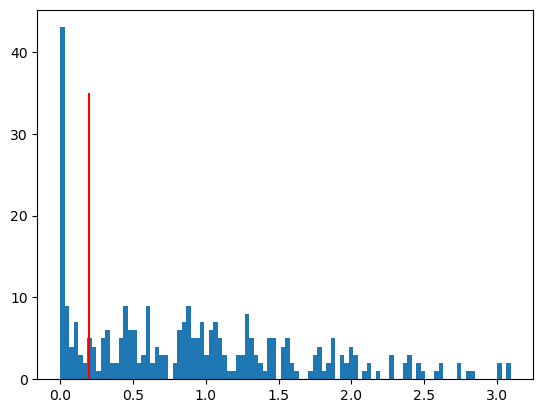

In [593]:
plt.hist(tfs_means.values, bins=100)
plt.vlines(0.2, 0, 35, color='red')
plt.show()

In [594]:
tfs_expressed = tfs_means.index.values[ tfs_means.values >= 0.2 ]
len(tfs_expressed)

242

In [596]:
##### Downloading the non-redundant vertebrate TFs from JASPAR
!wget https://jaspar.elixir.no/download/data/2024/CORE/JASPAR2024_CORE_vertebrates_non-redundant_pfms_jaspar.txt -O {out_dir}JASPAR2024_CORE_vertebrates_non-redundant_pfms_jaspar.txt

--2024-11-14 11:05:20--  https://jaspar.elixir.no/download/data/2024/CORE/JASPAR2024_CORE_vertebrates_non-redundant_pfms_jaspar.txt
Resolving jaspar.elixir.no (jaspar.elixir.no)... 158.39.48.179
Connecting to jaspar.elixir.no (jaspar.elixir.no)|158.39.48.179|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 283814 (277K) [text/plain]
Saving to: ‘/iblm/netapp/data4/bbalderson/edit_capture/data/t7_allelic_calling/superb_count_all10/combined/cell_qc_tables/JASPAR2024_CORE_vertebrates_non-redundant_pfms_jaspar.txt’

100%[======================================>] 283,814      420KB/s   in 0.7s   

2024-11-14 11:05:21 (420 KB/s) - ‘/iblm/netapp/data4/bbalderson/edit_capture/data/t7_allelic_calling/superb_count_all10/combined/cell_qc_tables/JASPAR2024_CORE_vertebrates_non-redundant_pfms_jaspar.txt’ saved [283814/283814]


In [598]:
from Bio import motifs

# Path to your JASPAR format file
file_path = f"{out_dir}JASPAR2024_CORE_vertebrates_non-redundant_pfms_jaspar.txt"

# Open the file and parse the motifs
with open(file_path) as f:
    jaspar_motifs = motifs.parse(f, "jaspar")

In [601]:
jaspar_motifs[0].name

'Arnt'

In [604]:
tfs_motifs = [motif for motif in jaspar_motifs if np.any([motif.name==tf for tf in tfs_expressed])]
tfs_names = [motif.name for motif in tfs_motifs]
len(tfs_motifs), tfs_names

(79,
 ['RELA',
  'ESR2',
  'MEF2B',
  'ZNF143',
  'E2F7',
  'MYBL2',
  'SMAD3',
  'TP53',
  'E2F1',
  'ZNF24',
  'NR2F6',
  'SMAD5',
  'SP1',
  'SP2',
  'SP4',
  'TFE3',
  'BACH1',
  'ZNF770',
  'ZNF184',
  'PGR',
  'ZNF175',
  'ATF7',
  'JUN',
  'BCL6',
  'CREB1',
  'CREB3L1',
  'CREM',
  'CTCF',
  'CTCF',
  'CTCF',
  'CTCFL',
  'E2F4',
  'E2F6',
  'EGR1',
  'ELF1',
  'MAX',
  'JUND',
  'JUND',
  'FOXK1',
  'FOXP1',
  'GABPA',
  'GATA1',
  'GATA2',
  'TCF3',
  'HIF1A',
  'IRF2',
  'KLF1',
  'KLF6',
  'NFE2',
  'MAZ',
  'MNT',
  'MNX1',
  'MXI1',
  'NFATC3',
  'NR2F2',
  'NR3C1',
  'RBPJ',
  'REST',
  'STAT1',
  'STAT3',
  'TCF12',
  'TCF4',
  'TEAD4',
  'TRPS1',
  'VEZF1',
  'ZBTB26',
  'ZBTB33',
  'ZBTB7A',
  'ZKSCAN1',
  'ZNF148',
  'ZNF189',
  'ZNF281',
  'ZNF282',
  'ZNF324',
  'ZNF341',
  'ZNF652',
  'ZNF740',
  'ZSCAN29',
  'TBP'])

In [630]:
crm_sequence = 'GTTGTGTGTGGAGCCGGTGTCCCGAGAGCGTGTCTGTGTGTTTTGGACTGTAAGGGAAAATGGCTGACGGCTCCGTCCCTCCCCCTCCTCCCCCTTCCCGTCCTGTCTGGGGCCGAGTAGGAGGATGGAGTCTCCGGGCGTGGCGGGCAGCCCCCCCGCCGTCCGCACCCGGGGGCCGGGTCGGTTTGGGGGCTGGCCGCCCCCCGCCCGGCGGCCGCTTTCCTACCCGGTCTGGTTCCACTTGACACCAAACGCCATTACTGAGGTGGAGTGATTTGGAGCTGGGGAGCTAGGCCTCGGCTACGCCTGGCTATCAGGCCTGACGACTTGTCCGCCTCCCCCCACCCTCCCGCGATAACCCGCAGTTTCTCCCCGGCCCTGGGCTCCTGGAGTGGGAGCTGGGTTATCGGCCTCCTACACCTCCTTCGCCCCGCTTTATTTGCAGAGGGCCAAAGCCGTGAAAGGGGTTTTTGAATGCAGAAATCGCTTCCAAGCTAGCTTGGACCTATTACCTTTCTATTTTTAACTGTTTCTGCAAATATTAGCATGTGCGAGTTTGGTAGTGATCAGGTCTTCAGATTCTTGTGACGTGAGGCTTAGGGTTGGATAAATGGCTGATTTTTCATTCATTGTGAAATAAGTTAAAGAGTTATACAGCAGGTGTGTAGATGGCTTCTTAAATTATTTGTGTGGATTTCTGTAGCGACTAGAACTTACACGAGAATTTGCAAAATTTCTAGTAGAACCTGCTTAAATTAAGCATGTTATTTTTTGGAAGTTCCATAGTTACAACGTTAATTGAATTTACACGGTGCAGTTTACAGGT'

In [631]:
len(crm_sequence)

826

In [632]:
from Bio.Seq import Seq

crm_seq = Seq(crm_sequence)

In [633]:
crm_seq

Seq('GTTGTGTGTGGAGCCGGTGTCCCGAGAGCGTGTCTGTGTGTTTTGGACTGTAAG...GGT')

In [634]:
#### Let's reduce the CRM seq to just a few bp around the USP9X cut site!
edit_site = ('chrX', 41086519)

In [635]:
crm_loc

('chrX', 41086293, 41087118)

In [636]:
edit_site_in_crm = edit_site[1] - crm_loc[1]
edit_site_in_crm

226

In [642]:
crm_seq[(edit_site_in_crm-2):(edit_site_in_crm+3)] # This makese sense!!!

Seq('ACCCG')

In [657]:
??pssm.search

Signature: pssm.search(sequence, threshold=0.0, both=True, chunksize=1000000)
Source:   
    def search(self, sequence, threshold=0.0, both=True, chunksize=10**6):
        """Find hits with PWM score above given threshold.

        A generator function, returning found hits in the given sequence
        with the pwm score higher than the threshold.
        """
        sequence = sequence.upper()
        seq_len = len(sequence)
        motif_l = self.length
        chunk_starts = np.arange(0, seq_len, chunksize)
        if both:
            rc = self.reverse_complement()
        for chunk_start in chunk_starts:
            subseq = sequence[chunk_start : chunk_start + chunksize + motif_l - 1]
            pos_scores = self.calculate(subseq)
            pos_ind = pos_scores >= threshold
            pos_positions = np.where(pos_ind)[0] + chunk_start
            pos_scores = pos_scores[pos_ind]
            if both:
                neg_scores = rc.calculate(subseq)
                neg_ind = 

In [691]:
hits = []
hit_tfs = []
search_lens = []
motif_lens = []
motif_seqs = []
hit_seq = []
motifs_ = []
for tf_name, tf_motif in zip(tfs_names, tfs_motifs):
    pssm = tf_motif.pssm

    motif_len = tf_motif.length

    # Only search in the sequence that would intersect the cut site, i.e.
    # the donor insertion would have to BE immediately at the TF binding site. 
    search_seq = crm_seq[(edit_site_in_crm-motif_len-1):edit_site_in_crm+motif_len]

    for hit in pssm.search( search_seq ):

        hits.append( hit )
        search_lens.append( len(search_seq) )
        motif_lens.append( motif_len )
        hit_tfs.append( tf_name )
        motif_seqs.append( tf_motif.consensus )
        motifs_.append( tf_motif )
        
        if hit[0] < 0:
            seq_ = search_seq.reverse_complement()[abs(hit[0])-motif_len:abs(hit[0])]
            hit_seq.append( (seq_.reverse_complement(), seq_) )
        else:
            seq_ = search_seq[abs(hit[0]):abs(hit[0])+motif_len]
            hit_seq.append( (seq_, seq_.reverse_complement()) )

In [692]:
search_seq.reverse_complement()

Seq('AGACCGGGTAGGAAA')

In [693]:
hits, hit_tfs, search_lens, motif_lens, motif_seqs, hit_seq

([(-16, 1.301592),
  (-18, 2.6986449),
  (-60, 1.174596),
  (32, 1.5678798),
  (-15, 6.3369184),
  (-19, 1.3446856),
  (1, 1.5588119),
  (-13, 5.746161),
  (-15, 0.26680905)],
 ['SP1', 'ZNF175', 'CTCF', 'CTCF', 'E2F6', 'ELF1', 'GABPA', 'RBPJ', 'ZBTB7A'],
 [19, 19, 63, 63, 17, 19, 21, 13, 19],
 [9, 9, 31, 31, 8, 9, 10, 6, 9],
 [Seq('GGGGCGGGG'),
  Seq('ACAGGAAGT'),
  Seq('CTGCAGTTCCAGCTGTGGCCACCAGGGGGCG'),
  Seq('CTGCAGTTCCAGCTGTGGCCACCAGGGGGCG'),
  Seq('GGCGGGAA'),
  Seq('CAGGAAGTG'),
  Seq('CACTTCCTGT'),
  Seq('TGGGAA'),
  Seq('CCGGAAGTG')],
 [(Seq('TTCCTACCC'), Seq('GGGTAGGAA')),
  (Seq('CTTTCCTAC'), Seq('GTAGGAAAG')),
  (Seq('CGCCCCCCGCCCGGCGGCCGCTTTCCTACCC'),
   Seq('GGGTAGGAAAGCGGCCGCCGGGCGGGGGGCG')),
  (Seq('CCGGTCTGGTTCCACTTGACACCAAACGCCA'),
   Seq('TGGCGTTTGGTGTCAAGTGGAACCAGACCGG')),
  (Seq('TTCCTACC'), Seq('GGTAGGAA')),
  (Seq('GCTTTCCTA'), Seq('TAGGAAAGC')),
  (Seq('GCTTTCCTAC'), Seq('GTAGGAAAGC')),
  (Seq('TTCCTA'), Seq('TAGGAA')),
  (Seq('TCCTACCCG'), Seq('CGGGTAGGA'))])

In [698]:
sp1_start = (edit_site[1]+(motif_lens[0]-1))-(abs(hits[0][0]))
sp1_loc = (sp1_start, sp1_start+motif_lens[0])
sp1_loc

(41086511, 41086520)

***Verifying if any of these have a peak in K562 cells in ENCODE***

SP1: https://www.encodeproject.org/experiments/ENCSR991ELG/
YES, directly at the USP9X edit site. AND the height of the reads is suggestive the TF binding site is at the USP9X edit site.

ZNF175: https://www.encodeproject.org/experiments/ENCSR011PEI/
NO

CTCF: https://www.encodeproject.org/experiments/ENCSR000EGM/
NO

E2F6: https://www.encodeproject.org/experiments/ENCSR000BLI/
YES, BUT the peak centre appears further upstream from the USP9X edit site, suggesting the TF binding site is more upstream.

ELF1: https://www.encodeproject.org/experiments/ENCSR975SSR/
NO

GABPA: https://www.encodeproject.org/experiments/ENCSR290MUH/
YES, but very broad and weak peak, suggest of perhaps not being a good candidate.

RBPJ: https://www.encodeproject.org/experiments/ENCSR740XMB/
NO

ZBTB7A: https://www.encodeproject.org/experiments/ENCSR000BME/
YES, and the peak seems to hint at plausibility the binding site is at the edit location! But is a poor motif score.

In [685]:
print(motifs_[0]) ### Looks like a legit binding site for SP1...

TF name	SP1
Matrix ID	MA0079.5
Matrix:
        0      1      2      3      4      5      6      7      8
A:   1.00   1.00   1.00   1.00 267.00   1.00   1.00 254.00 161.00
C:   1.00   1.00   1.00   1.00 731.00   1.00  85.00  52.00   1.00
G: 950.00 997.00 997.00 997.00   1.00 997.00 912.00 659.00 836.00
T:  47.00   1.00   1.00   1.00   1.00   1.00   1.00  35.00   1.00


In [703]:
motifs_[0].reverse_complement()

In [705]:
?logomaker.Logo

Init signature:
logomaker.Logo(
    df,
    color_scheme=None,
    font_name='sans',
    stack_order='big_on_top',
    center_values=False,
    baseline_width=0.5,
    flip_below=True,
    shade_below=0.0,
    fade_below=0.0,
    fade_probabilities=False,
    vpad=0.0,
    vsep=0.0,
    alpha=1.0,
    show_spines=None,
    ax=None,
    zorder=0,
    figsize=(10, 2.5),
    **kwargs,
)
Docstring:     
Logo represents a basic logo, drawn on a specified axes object
using a specified matrix, which is supplied as a pandas dataframe.

attributes
----------

df: (pd.DataFrame)
    A matrix specifying character heights and positions. Rows correspond
    to positions while columns correspond to characters. Column names
    must be single characters and row indices must be integers.

color_scheme: (str, dict, or array with length 3)
    Specification of logo colors. Default is 'gray'. Can take a variety of
    forms.
     - (str) A built-in Logomaker color scheme in which the color of each
     c

In [711]:
motif.counts

{'A': [1.0, 35.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 47.0],
 'C': [836.0, 659.0, 912.0, 997.0, 1.0, 997.0, 997.0, 997.0, 950.0],
 'G': [1.0, 52.0, 85.0, 1.0, 731.0, 1.0, 1.0, 1.0, 1.0],
 'T': [161.0, 254.0, 1.0, 1.0, 267.0, 1.0, 1.0, 1.0, 1.0]}

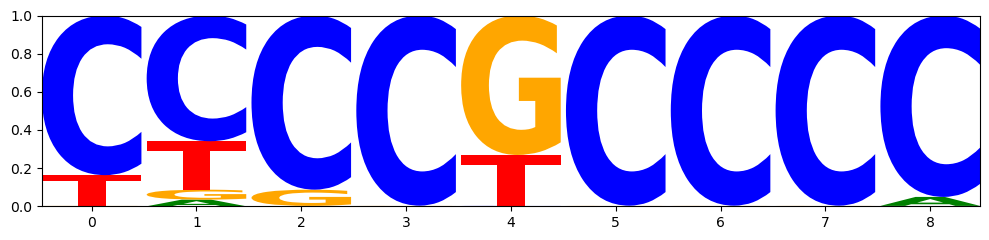

In [717]:
import logomaker

motif = motifs_[0].reverse_complement()

counts_df = pd.DataFrame(motif.pwm)

# Normalize counts to probabilities for a clearer logo
#logo_df = counts_df.div(counts_df.sum(axis=1), axis=0)

#logomaker.Logo(logo_df)
logomaker.Logo(counts_df)
plt.show()

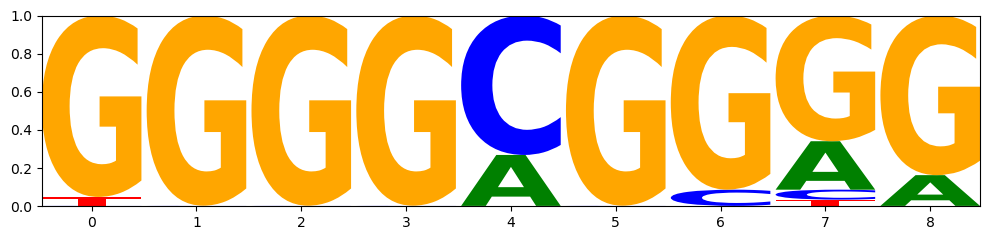

In [716]:
import logomaker

motif = motifs_[0]

counts_df = pd.DataFrame(motif.pwm)

# Normalize counts to probabilities for a clearer logo
#logo_df = counts_df.div(counts_df.sum(axis=1), axis=0)

#logomaker.Logo(logo_df)
logomaker.Logo(counts_df)
plt.show()

Looking for SP1 KD data, I found this paper where the knocked-down SP1 in HEK293T cells and performed RNA-seq: 

    https://www.cell.com/molecular-cell/pdf/S1097-2765(22)00649-9.pdf

Although I cannot see the SP1 binding site in HEK293T ChIP-seq in ENCODE: 

    https://www.encodeproject.org/experiments/ENCSR906PEI/
    

In Table S3 they list the DE genes, which INCLUDES USP9X!!!!! This is the significance:

In [ ]:
ID	NAME	siMock.cRPKM	siSP1.cRPKM	siSP1.log2FC	siSP1.PValue	siSP1.FDR
ENSG00000124486	USP9X	61.53	26.735	-1.04907006220249	2.63e-08	2.86e-07

This paper also knocked-down USP9X:
    
    https://onlinelibrary.wiley.com/doi/10.1002/mc.23591

In supp table 3 with the DE results in breast cancer. Could not see NRF1 DE, or many of the targets, but could see these targets as DE specific to USP9X down-regulation: 

    BRD2, all others I could not find.

Putting this all together in IGV to make a visualisation, can see the session here I used:

    data/edit_capture/superb_count_all10/USP9X_edit_dissection.xml